**Author**: **Ammar Waddah**

# Kaggle Promotes

**Kaggle**

In [ ]:
# Install kaggle packages.
!pip install kaggle

In [ ]:
# Create kaggle dir.
!mkdir -p ~/.kaggle/

In [ ]:
# Move 'kaggle.json' into the folder where the API expects to find it.
!mv kaggle.json ~/.kaggle/

In [ ]:
# Change permissions so that only me can read and write.
!chmod 600 ~/.kaggle/kaggle.json

**Kaggle dataset preperation**

In [ ]:
# Download kaggle competition dataset.
!kaggle competitions download -c shai-level-2-training-2023

 99% 523M/526M [00:20<00:00, 29.2MB/s]
100% 526M/526M [00:20<00:00, 26.4MB/s]


In [ ]:
# Print downloaded files.
!ls

sample_data  shai-level-2-training-2023.zip


In [ ]:
# Unzip the dataset file.
!unzip shai-level-2-training-2023.zip

In [ ]:
# Print unzipped files.
!ls

sample_data	       shai-level-2-training-2023.zip  train
sample_submission.csv  test			       train.csv


# Import Dependencies

In [ ]:
# Handling data.
import numpy as np
import copy
# Dataframe handling.
import pandas as pd
import os
# Visualizing libraries.
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import PIL
from PIL import Image
import cv2
from tqdm import tqdm
# Data transformers and preprocessing.
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
# Dealing with transfer learning and callbacks.
import tensorflow as tf
from keras.applications import DenseNet201, VGG16, VGG19, InceptionV3, ResNet50
from keras.callbacks import ModelCheckpoint
import keras.backend as K
# Compute metrics.
from sklearn.metrics import classification_report, confusion_matrix
# Dealing with imbalanced data.
from sklearn.utils import compute_class_weight

# Load the dataset and labels

**Discussion Stage**
* In case of having a CSV file, we don't have to use manual fetch of the files using their folders, but instead we could address images urls and labels to a CSV file.

# Fetch data and read CSV file

In [ ]:
# Define the path to the dataset.
data_path = "/content/"
train_path = os.path.join(data_path, "train")
train_csv_path = os.path.join(data_path, "train.csv")
# Read csv file.
fetched_data= pd.read_csv(train_csv_path)
fetched_data

,Image,Label
0,597631776.jpeg,normal
1,35266064.jpeg,virus
2,467414642.jpeg,normal
3,35667640.jpeg,normal
4,618841263.jpeg,normal
...,...,...
1191,118777221.jpeg,virus
1192,375945707.jpeg,normal
1193,531745860.jpeg,virus
1194,121544623.jpeg,covid


**Discussion Stage**
* Here we can see that there are 1196 images, and 2 columns defines images, labels.

## About the Dataset

**Context**
* The whole world is suffering from COVID-19 disease and its proper and timely diagnosis is the need of the hour. So for building an efficient AI-based diagnostic system we have collected Chest ray images from different sources so that we can train our CNN model for automating the whole diagnosis method. Therefore we have collected Chest ray images from different sources and research papers and combined them to create one comprehensive dataset that can be used by research community.

* This dataset is also used in COVID Lite paper which has shown significant results by building novel CNN based solution.

**Content**

* This dataset consists of a posteroanterior (PA) view of chest X-ray images comprising Normal, Viral, and CVOID-19 affected patients. There are total 1709 CXR images.

## Build CSV URLs of each image name

**Get benefits by using CSV file provided in this competition by joining image path in front of each image name.**

In [ ]:
# Build images URLs.
for image_name in range(fetched_data.shape[0]):
    fetched_data.loc[image_name,'Image'] =  train_path + "/" + fetched_data.loc[image_name,'Label'] + "/" + fetched_data.loc[image_name,'Image']

In [ ]:
# Recheck the CSV file.
fetched_data

,Image,Label
0,/content/train/normal/597631776.jpeg,normal
1,/content/train/virus/35266064.jpeg,virus
2,/content/train/normal/467414642.jpeg,normal
3,/content/train/normal/35667640.jpeg,normal
4,/content/train/normal/618841263.jpeg,normal
...,...,...
1191,/content/train/virus/118777221.jpeg,virus
1192,/content/train/normal/375945707.jpeg,normal
1193,/content/train/virus/531745860.jpeg,virus
1194,/content/train/covid/121544623.jpeg,covid


**Discussion Stage**
* Now all images data in the CSV have the accurate url of its directory. 

# Label Encoder

**This step relates to Preprocess step, but for better evaluation and deals with the dataset I decided to address it here.**

In [ ]:
# Since that we have Object type that indicates images labels, we have to convert it to one hot encoder.
label_encoder = LabelEncoder()
# Assigning numerical values and storing it in another column.
fetched_data["Encoded_Label"] = label_encoder.fit_transform(fetched_data["Label"])
fetched_data

,Image,Label,Encoded_Label
0,/content/train/normal/597631776.jpeg,normal,1
1,/content/train/virus/35266064.jpeg,virus,2
2,/content/train/normal/467414642.jpeg,normal,1
3,/content/train/normal/35667640.jpeg,normal,1
4,/content/train/normal/618841263.jpeg,normal,1
...,...,...,...
1191,/content/train/virus/118777221.jpeg,virus,2
1192,/content/train/normal/375945707.jpeg,normal,1
1193,/content/train/virus/531745860.jpeg,virus,2
1194,/content/train/covid/121544623.jpeg,covid,0


In [ ]:
# Get an illustration map of each encoded label we had dealt with.
reverse_mapping = {label: index for label, index in enumerate(label_encoder.classes_)}
reverse_mapping

{0: 'covid', 1: 'normal', 2: 'virus'}

## Remove useless columns and prepare the dataset

In [ ]:
# Remove Label column.
encoded_data = fetched_data.drop(columns = ["Label"], axis = 1)
encoded_data

,Image,Encoded_Label
0,/content/train/normal/597631776.jpeg,1
1,/content/train/virus/35266064.jpeg,2
2,/content/train/normal/467414642.jpeg,1
3,/content/train/normal/35667640.jpeg,1
4,/content/train/normal/618841263.jpeg,1
...,...,...
1191,/content/train/virus/118777221.jpeg,2
1192,/content/train/normal/375945707.jpeg,1
1193,/content/train/virus/531745860.jpeg,2
1194,/content/train/covid/121544623.jpeg,0


# Check files validation

In [ ]:
for filename in encoded_data["Image"]:
  # Specify the validate extension of each file we can deal with.
  if filename.endswith('.JPG') or filename.endswith('.png') or filename.endswith('.jpeg'):
    try:
      img = Image.open(filename)  # open the image file.
      img.verify()  # verify that it is, in fact an image.
      img.close() # reload is necessary in my case.
      im = Image.open(filename)
      im.transpose(PIL.Image.FLIP_LEFT_RIGHT)
      im.close()
      if filename == encoded_data["Image"].iloc[-1]:
        print("All files are Valid")
    except (IOError, SyntaxError) as e:
      # Print and delete damaged file.
      print(filename)
      encoded_data.drop(index = (encoded_data[encoded_data["Image"] == filename].index), inplace = True)

All files are Valid


**Discussion Stage**
* There are no interrupted files

# Exploratory Data Analysis (EDA)

In [ ]:
# Get some info about the data.
encoded_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1196 entries, 0 to 1195
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Image          1196 non-null   object
 1   Encoded_Label  1196 non-null   int64 
dtypes: int64(1), object(1)
memory usage: 18.8+ KB


In [ ]:
# Get more info about the data if we can.
encoded_data.describe()

,Encoded_Label
count,1196.000000
mean,1.115385
std,0.771933
min,0.000000
25%,1.000000
50%,1.000000
75%,2.000000
max,2.000000


**Discussion Stage**
* There are no null values, and normal label is the largest label.

In [ ]:
# Get class names.
classes = fetched_data["Label"].unique().tolist()

**Display the distribution of each class**

The training samples of class 0 -> normal is (295,)
The training samples of class 1 -> virus is (468,)
The training samples of class 2 -> covid is (433,)


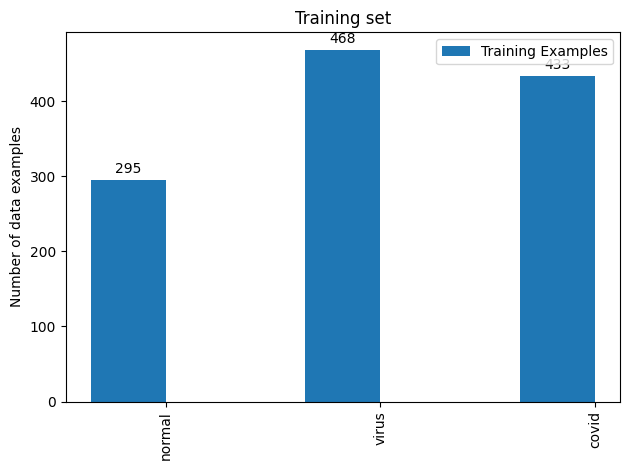

In [ ]:
# Place holder of each class count in the dataset.
list_classes_train = []
# Gathering the counts of each class.
for index in range(len(np.unique(encoded_data["Encoded_Label"]))):
    idx_train = np.where(encoded_data == index)
    idx_train = idx_train[0]
    x_train, y_train = encoded_data["Image"][idx_train], encoded_data["Encoded_Label"][idx_train]

    print("The training samples of class {} -> {} is {}" .format(index, classes[index], x_train.shape))
    # Append each class to the list containing its count.
    list_classes_train.append(x_train.shape[0])

x = np.arange(len(classes))
width = 0.35

# Configure plots.
fig, ax = plt.subplots()

train_rects = ax.bar(x - width/2, list_classes_train, width, label='Training Examples')

ax.set_ylabel('Number of data examples')
ax.set_title('Training set')
ax.set_xticks(x)
ax.set_xticklabels(classes, rotation = 90)
ax.legend()

def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(train_rects)

fig.tight_layout()

plt.show()

**Discussion Stage**
* There are some differences between data samples count, dataset not balanced and we have to deal with it.

## Check and manipulated with images by visualizing each class of them

**Create placeholder variables**

In [ ]:
# Choose index to end with.
idx = 10
# Choose random number.
random_idx = np.random.randint(idx, 200 - idx)
# Get covid variable.
first_samples_label = encoded_data[encoded_data["Encoded_Label"] == [key for key, val in reverse_mapping.items() if val == reverse_mapping[0]][0]]["Image"].iloc[random_idx: (random_idx+ idx)]
# Get normal variable.
second_samples_label = encoded_data[encoded_data["Encoded_Label"] == [key for key, val in reverse_mapping.items() if val == reverse_mapping[1]][0]]["Image"].iloc[random_idx: (random_idx+ idx)]
# Get virus variable.
third_samples_label = encoded_data[encoded_data["Encoded_Label"] == [key for key, val in reverse_mapping.items() if val == reverse_mapping[2]][0]]["Image"].iloc[random_idx: (random_idx+ idx)]

In [ ]:
def visualize_images_by_label(img, label):
  '''
  This function visualises each image in the dataset depending on its label.
  Args: img - indicates dataset images.
        label - indicates images labels.
  Returns: visualise each image in the dataset.
  '''
  plt.figure(figsize= (10, 10))
  no_of_images = 9
  no_of_columns = 3
  for index in range(no_of_images):
      plt.subplot(int(np.ceil(no_of_images/ no_of_columns)), 3, index + 1)
      read_img = plt.imread(img[index])
      plt.imshow(read_img)
      print(f"The Image shape is: {read_img.shape}")
      print(f"The Image dtype is: {read_img.dtype}")
      plt.title(label)
      plt.axis('off')
  return plt.show()

The Image shape is: (1448, 1592, 3)
The Image dtype is: uint8
The Image shape is: (1125, 1200, 3)
The Image dtype is: uint8
The Image shape is: (480, 640)
The Image dtype is: float32
The Image shape is: (480, 640, 3)
The Image dtype is: float32
The Image shape is: (411, 477, 3)
The Image dtype is: uint8
The Image shape is: (480, 640, 3)
The Image dtype is: float32
The Image shape is: (440, 610)
The Image dtype is: uint8
The Image shape is: (362, 445, 4)
The Image dtype is: float32
The Image shape is: (1024, 931)
The Image dtype is: uint8


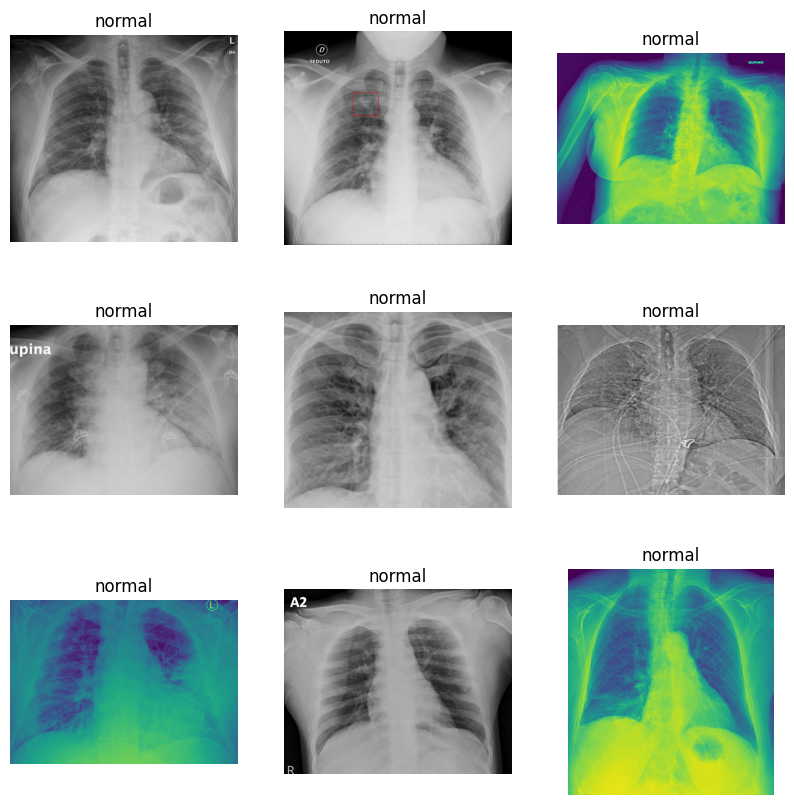

In [ ]:
# Visualize normal cases only in the dataset.
visualize_images_by_label(first_samples_label.reset_index(drop = True), classes[0])

**Discussion Stage**
* There are real scaled images with float32 and uint8 types RGB and gray scaled, and there is some of it take an RGB array of images.

The Image shape is: (1650, 2136)
The Image dtype is: uint8
The Image shape is: (1260, 1632)
The Image dtype is: uint8
The Image shape is: (1205, 1538)
The Image dtype is: uint8
The Image shape is: (1208, 1384)
The Image dtype is: uint8
The Image shape is: (1294, 1500)
The Image dtype is: uint8
The Image shape is: (1445, 2022)
The Image dtype is: uint8
The Image shape is: (1554, 1970)
The Image dtype is: uint8
The Image shape is: (1105, 1402)
The Image dtype is: uint8
The Image shape is: (1264, 1600)
The Image dtype is: uint8


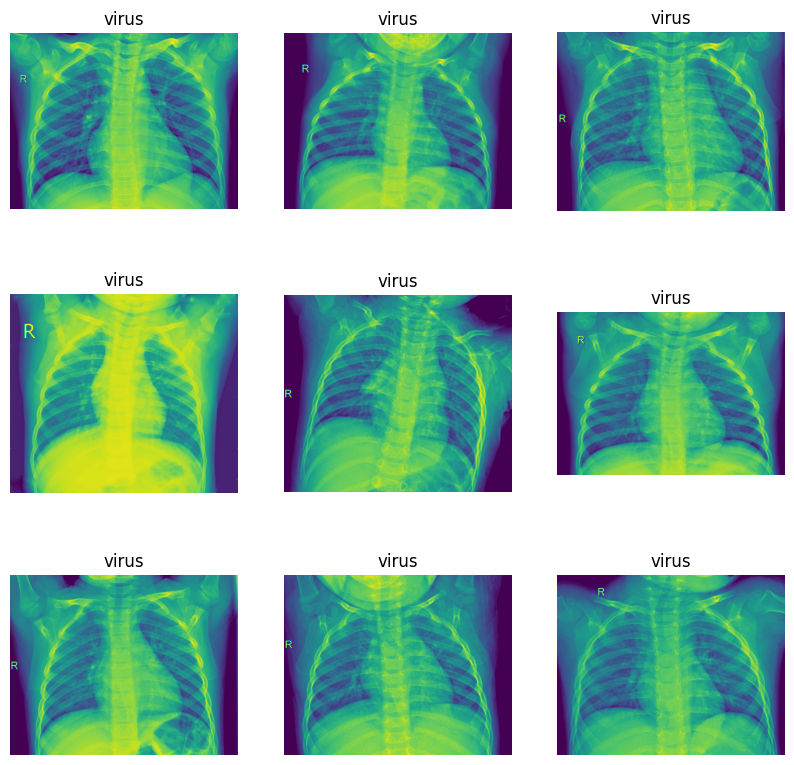

In [ ]:
# Visualize virus cases only in the dataset.
visualize_images_by_label(second_samples_label.reset_index(drop = True), classes[1])

**Discussion Stage**
* There are real gray scaled images with int types (not normalized), are uint8, and there is some of it take an RGB array of images.

The Image shape is: (840, 1200)
The Image dtype is: uint8
The Image shape is: (1232, 1760)
The Image dtype is: uint8
The Image shape is: (696, 1312)
The Image dtype is: uint8
The Image shape is: (728, 1208)
The Image dtype is: uint8
The Image shape is: (936, 1352)
The Image dtype is: uint8
The Image shape is: (744, 968)
The Image dtype is: uint8
The Image shape is: (632, 1064)
The Image dtype is: uint8
The Image shape is: (784, 1168)
The Image dtype is: uint8
The Image shape is: (1088, 1192)
The Image dtype is: uint8


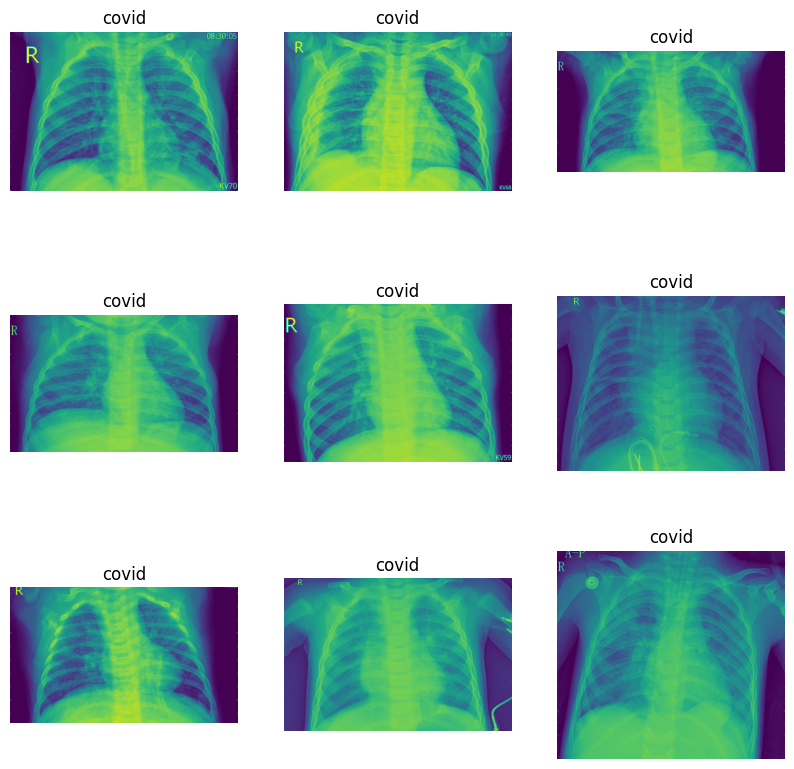

In [ ]:
# Visualize covid cases only in the dataset.
visualize_images_by_label(third_samples_label.reset_index(drop = True), classes[2])

**Check images shape**

In [ ]:
def examples_shapes(dataset):
  '''
  This function returns the minimum size of each image in the dataset.
  Args: dataset images.
  Returns: minimum size of the images in the dataset.
  '''
  axis_1 = []
  axis_2 = []
  for features in dataset:
    image= plt.imread(features)
    axis_1.append(image.shape[0])
    axis_2.append(image.shape[1])
  # check the third channel of images
  print(image.shape)
  return axis_1, axis_2

In [ ]:
# Call the function and return the its sizes.
axis_1, axis_2 = examples_shapes(encoded_data["Image"])

(888, 1232)


<Axes: ylabel='Count'>

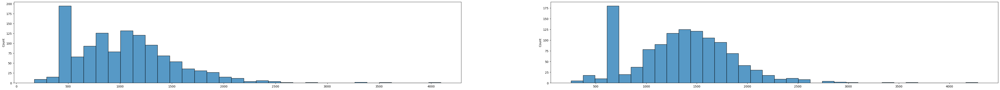

In [ ]:
# Check the count of images sizes in the dataset classes.
plt.figure(figsize= (60, 5))
plt.subplot(1, 2, 1)
sns.histplot(axis_1)
plt.subplot(1, 2, 2)
sns.histplot(axis_2)

**Discussion Stage**
* The Covid class and some images from Virus are represented as RGB array of images and it's float type (normalized), and the others are uint8.

In [ ]:
# Take the average of the images shape.
(FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2) = int(np.average(axis_1)/4), int(np.average(axis_2)/4)
(FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2)

(260, 336)

# Preprocess the dataset

## Split the data

In [ ]:
# Split the data and labels into training and Validation sets.
train_data, val_data, train_labels, val_labels = train_test_split(encoded_data["Image"], encoded_data["Encoded_Label"],
                                                                  test_size = 0.2, shuffle = True, stratify = encoded_data["Encoded_Label"], random_state = 42)

In [ ]:
# Split the data and labels into Validation and Test sets.
val_data, test_data, val_labels, test_labels = train_test_split(val_data, val_labels,
                                                                  test_size = 0.5, shuffle = True, stratify = val_labels, random_state = 42)

In [ ]:
# Reset indexes.
train_data = train_data.reset_index(drop = True)
val_data = val_data.reset_index(drop = True)
test_data = test_data.reset_index(drop = True)
train_labels = train_labels.reset_index(drop = True)
val_labels = val_labels.reset_index(drop = True)
test_labels = test_labels.reset_index(drop = True)

In [ ]:
# Check the shape of each variable.
print(f'''
The shape of Training data is: {train_data.shape}\n
The shape of Validation data is: {val_data.shape}\n
The shape of Test data is: {val_data.shape}\n
The shape of Training Labels is: {train_labels.shape}\n
The shape of Validation Labels is: {val_data.shape}\n
The shape of Test Labels is: {test_data.shape}\n
'''
)


The shape of Training data is: (956,)

The shape of Validation data is: (120,)

The shape of Test data is: (120,)

The shape of Training Labels is: (956,)

The shape of Validation Labels is: (120,)

The shape of Test Labels is: (120,)




### **Check the distribution of labeled data**

In [ ]:
# Create figure of the training classes distribution.
plt.figure(figsize= (10, 10))
# Concat train and labels data.
train_df = pd.concat([train_data, train_labels], axis = 1)
# Plot histogram that indicates the train data distribution.
px.histogram(train_df, y="Encoded_Label", color="Encoded_Label", title="Train Classes Distribution").update_yaxes(categoryorder='total ascending')

<Figure size 1000x1000 with 0 Axes>

In [ ]:
# Create figure of the validation classes distribution.
plt.figure(figsize= (10, 10))
# Concat validation and labels data.
val_df = pd.concat([val_data, val_labels], axis = 1)
# Plot histogram that indicates the validation data distribution.
px.histogram(val_df, y="Encoded_Label", color="Encoded_Label", title="Validation Classes Distribution").update_yaxes(categoryorder='total ascending')

<Figure size 1000x1000 with 0 Axes>

In [ ]:
# Create figure of the validation classes distribution.
plt.figure(figsize= (10, 10))
# Concat test and labels data.
test_df = pd.concat([test_data, test_labels], axis = 1)
# Plot histogram that indicates the test data distribution.
px.histogram(test_df, y="Encoded_Label", color="Encoded_Label", title="Test Classes Distribution").update_yaxes(categoryorder='total ascending')

<Figure size 1000x1000 with 0 Axes>

**Discussion Stage**
* We can ensure that these splits have the same distribution.

### **Print the parentage of each split of the dataset**

The training samples of class 0 -> normal is (236,)
The validation samples of class 0 -> normal is (29,)
The test samples of class 0 -> normal is (30,)
The training samples of class 1 -> virus is (374,)
The validation samples of class 1 -> virus is (47,)
The test samples of class 1 -> virus is (47,)
The training samples of class 2 -> covid is (346,)
The validation samples of class 2 -> covid is (44,)
The test samples of class 2 -> covid is (43,)


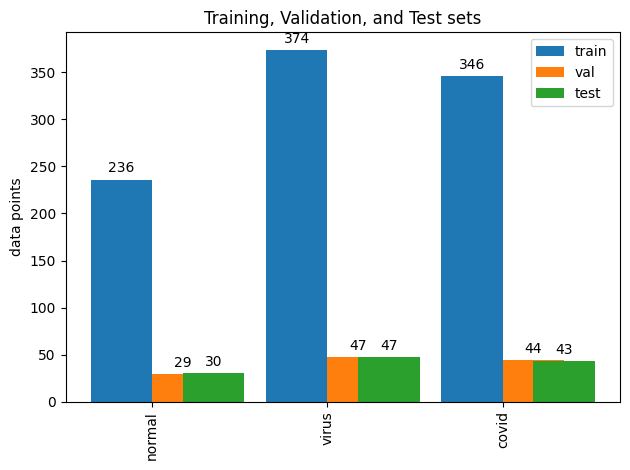

In [ ]:
# Place holder of each class.
list_classes_train = []
list_classes_val = []
list_classes_test = []
# Compute the counts of each class.
for index in range(len(np.unique(encoded_data["Encoded_Label"]))):

  idx_train = np.where(train_labels == index)
  idx_train = idx_train[0]
  x_train, y_train = train_data.iloc[idx_train], train_labels.iloc[idx_train]

  idx_val = np.where(val_labels == index)
  idx_val = idx_val[0]
  x_val, y_val = val_data.iloc[idx_val], val_labels.iloc[idx_val]

  idx_test = np.where(test_labels == index)
  idx_test = idx_test[0]
  x_test, y_test = test_data.iloc[idx_test], test_labels.iloc[idx_test]

  print("The training samples of class {} -> {} is {}" .format(index, classes[index], x_train.shape))
  print("The validation samples of class {} -> {} is {}" .format(index, classes[index], x_val.shape))
  print("The test samples of class {} -> {} is {}" .format(index, classes[index], x_test.shape))

  list_classes_train.append(x_train.shape[0])
  list_classes_val.append(x_val.shape[0])
  list_classes_test.append(x_test.shape[0])

x = np.arange(len(classes))
width = 0.35
# Configure plots.
fig, ax = plt.subplots()

train_rects = ax.bar(x - width/2, list_classes_train, width, label='train')
val_rects = ax.bar(x + width/2, list_classes_val, width, label='val')
test_rects = ax.bar(x + width, list_classes_test, width, label='test')

ax.set_ylabel('data points')
ax.set_title('Training, Validation, and Test sets')
ax.set_xticks(x)
ax.set_xticklabels(classes, rotation = 90)
ax.legend()


def autolabel(rects):
  """Attach a text label above each bar in *rects*, displaying its height."""
  for rect in rects:
      height = rect.get_height()
      ax.annotate('{}'.format(height),
                  xy=(rect.get_x() + rect.get_width() / 2, height),
                  xytext=(0, 3),  # 3 points vertical offset
                  textcoords="offset points",
                  ha='center', va='bottom')


autolabel(train_rects)
autolabel(val_rects)
autolabel(test_rects)
fig.tight_layout()

plt.show()

## **Compute classes weight**

In [ ]:
# Get class weight for each class because of the imbalanced case in data.
class_weights = compute_class_weight(
                                        class_weight = "balanced",
                                        classes = np.unique(train_labels),
                                        y = train_labels                                                    
                                    )
class_weights = dict(zip(np.unique(train_labels), class_weights))
class_weights

{0: 1.3502824858757063, 1: 0.8520499108734403, 2: 0.9210019267822736}

**Discussion Stage**
* Based on the plot above, I can be sure that the split works good and the state of imbalanced data stayed the same.

### **Check some images in these two sets**

In [ ]:
def visualize_images(img, label):
  '''
  This function visualises each image in the dataset and indicate its label.
  Args: img - indicates dataset images.
        label - indicates image labels.
  Returns: visualise each image in the dataset and its label.
  '''
  plt.figure(figsize= (10, 10))
  no_of_images = 9
  no_of_columns = 3
  for index in range(no_of_images):
      plt.subplot(int(np.ceil(no_of_images/ no_of_columns)), 3, index + 1)
      read_img = plt.imread(img[index])
      plt.imshow(read_img, cmap = "gray")
      plt.title(reverse_mapping[label.iloc[index]])
      plt.axis('off')
  return plt.show()

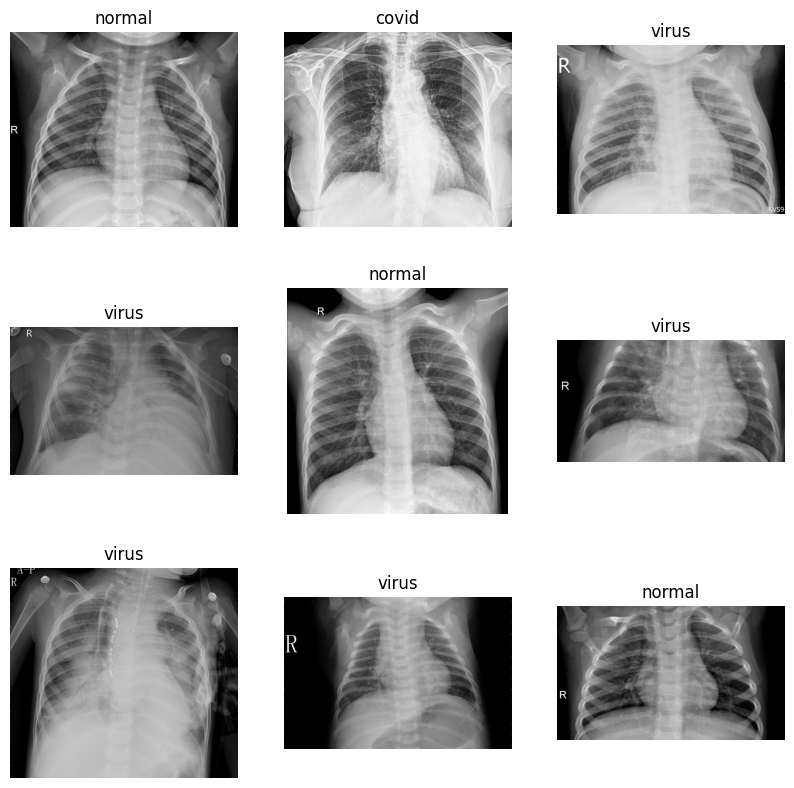

In [ ]:
# Check training images.
visualize_images(train_data, train_labels)

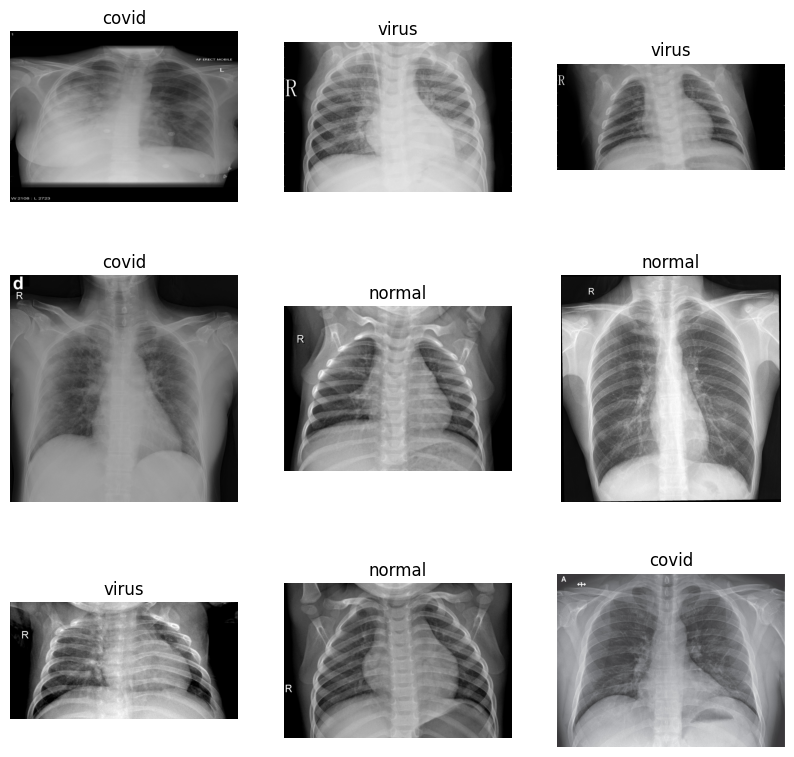

In [ ]:
# Check validation images.
visualize_images(val_data, val_labels)

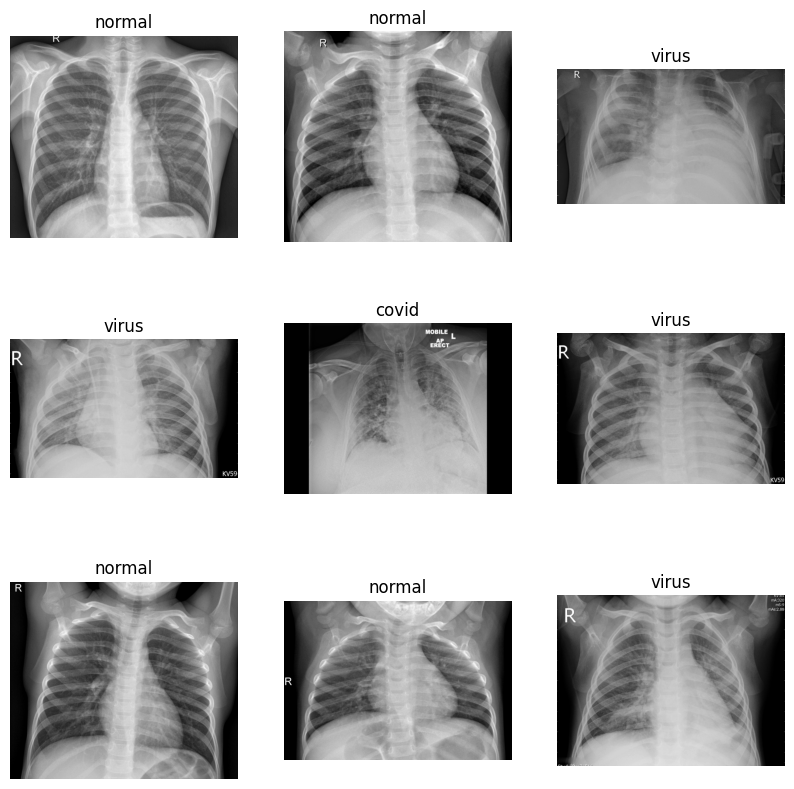

In [ ]:
# Check test images.
visualize_images(test_data, test_labels)

### ReCreate Datafarmes (Train, Validation, Test)

In [ ]:
# ReCreate training dataframe (train data and labeled data).
train_dataframe = pd.concat([train_data, train_labels], axis = 1, ignore_index=True)
train_dataframe.rename(columns= {0: 'Image', 1: 'Label'}, inplace = True)
train_dataframe

,Image,Label
0,/content/train/normal/499479437.jpeg,1
1,/content/train/covid/5355949.png,0
2,/content/train/virus/590345812.jpeg,2
3,/content/train/virus/52380457.jpeg,2
4,/content/train/normal/17113727.jpeg,1
...,...,...
951,/content/train/normal/135586766.jpeg,1
952,/content/train/normal/62011093.jpeg,1
953,/content/train/normal/70345750.jpeg,1
954,/content/train/virus/333323247.jpeg,2


In [ ]:
# Convert label data to string data type.
train_dataframe["Label"] = train_dataframe["Label"].apply(lambda x: str(x))
train_dataframe

,Image,Label
0,/content/train/normal/499479437.jpeg,1
1,/content/train/covid/5355949.png,0
2,/content/train/virus/590345812.jpeg,2
3,/content/train/virus/52380457.jpeg,2
4,/content/train/normal/17113727.jpeg,1
...,...,...
951,/content/train/normal/135586766.jpeg,1
952,/content/train/normal/62011093.jpeg,1
953,/content/train/normal/70345750.jpeg,1
954,/content/train/virus/333323247.jpeg,2


In [ ]:
# Recreate validation dataframe (validation data and labeled data).
validation_dataframe = pd.concat([val_data, val_labels], axis = 1, ignore_index=True)
validation_dataframe.rename(columns= {0: 'Image', 1: 'Label'}, inplace = True)
validation_dataframe

,Image,Label
0,/content/train/covid/367974345.png,0
1,/content/train/virus/60925477.jpeg,2
2,/content/train/virus/422367643.jpeg,2
3,/content/train/covid/147287905.jpg,0
4,/content/train/normal/398904381.jpeg,1
...,...,...
115,/content/train/normal/2580896.jpeg,1
116,/content/train/normal/369353307.jpeg,1
117,/content/train/virus/193802713.jpeg,2
118,/content/train/covid/140679403.jpeg,0


In [ ]:
# Convert label data to string data type.
validation_dataframe["Label"] = validation_dataframe["Label"].apply(lambda x: str(x))
validation_dataframe

,Image,Label
0,/content/train/covid/367974345.png,0
1,/content/train/virus/60925477.jpeg,2
2,/content/train/virus/422367643.jpeg,2
3,/content/train/covid/147287905.jpg,0
4,/content/train/normal/398904381.jpeg,1
...,...,...
115,/content/train/normal/2580896.jpeg,1
116,/content/train/normal/369353307.jpeg,1
117,/content/train/virus/193802713.jpeg,2
118,/content/train/covid/140679403.jpeg,0


In [ ]:
# Recreate test dataframe (test data and labeled data).
test_dataframe = pd.concat([test_data, test_labels], axis = 1, ignore_index=True)
test_dataframe.rename(columns= {0: 'Image', 1: 'Label'}, inplace = True)
test_dataframe

,Image,Label
0,/content/train/normal/242456324.jpeg,1
1,/content/train/normal/134351884.jpeg,1
2,/content/train/virus/57875698.jpeg,2
3,/content/train/virus/254368911.jpeg,2
4,/content/train/covid/411190304.png,0
...,...,...
115,/content/train/normal/148660819.jpeg,1
116,/content/train/virus/496593614.jpeg,2
117,/content/train/covid/406270137.png,0
118,/content/train/virus/81411175.jpeg,2


In [ ]:
# Convert label data to string data type.
test_dataframe["Label"] = test_dataframe["Label"].apply(lambda x: str(x))
test_dataframe

,Image,Label
0,/content/train/normal/242456324.jpeg,1
1,/content/train/normal/134351884.jpeg,1
2,/content/train/virus/57875698.jpeg,2
3,/content/train/virus/254368911.jpeg,2
4,/content/train/covid/411190304.png,0
...,...,...
115,/content/train/normal/148660819.jpeg,1
116,/content/train/virus/496593614.jpeg,2
117,/content/train/covid/406270137.png,0
118,/content/train/virus/81411175.jpeg,2


## Data Augmentation

In [ ]:
# IMAGE_SHAPE = 224
# Define tensor SEED.
SEED = 42
tf.random.set_seed(SEED)

def create_augmented_splites(train_dataframe, val_dataframe, test_dataframe, train_path, batch_size, IMG_SIZE):
  '''
  This function returns augmentation splits.
  Args: train_dataframe- dataframe indicates the training data.
        val_dataframe - dataframe indicates validation data.
        test_dataframe - dataframe indicates test data.
        train_path - path indicates the dataset path.
        batch_size - indicates the size of the mini-batch
        IMG_SIZE - tuple indicates the size of images.
  Returns: Train, Validation, and Test augmented splits.
  '''
  train_datagen = ImageDataGenerator(
          rescale = 1./255,
          zoom_range = (0.8, 1.2),
          rotation_range = 10,                                        
          width_shift_range = 0.1,
          height_shift_range = 0.1,
          shear_range = 10,
          horizontal_flip = True,
          fill_mode = 'nearest'
  )

  val_datagen = ImageDataGenerator(
      rescale = 1./255
  )

  training_set = train_datagen.flow_from_dataframe(
                                              dataframe = train_dataframe,
                                              directory=train_path,
                                              x_col= "Image",
                                              y_col= "Label",
                                              target_size = (IMG_SIZE[0], IMG_SIZE[1]),
                                              batch_size = BATCH_SIZE,
                                              class_mode = 'categorical',
                                              color_mode='rgb',
                                              seed = SEED,
                                              shuffle=False
                                              )

  validation_set = val_datagen.flow_from_dataframe(
                                              dataframe = validation_dataframe,
                                              directory=train_path,
                                              x_col = "Image",
                                              y_col = "Label",
                                              target_size = (IMG_SIZE[0], IMG_SIZE[1]),
                                              batch_size = BATCH_SIZE,
                                              class_mode = 'categorical',
                                              color_mode='rgb',
                                              seed=SEED,
                                              shuffle=False
                                              )

  test_set =    val_datagen.flow_from_dataframe(
                                              dataframe=test_dataframe,
                                              directory=train_path,
                                              x_col="Image",
                                              y_col="Label",
                                              class_mode="categorical",
                                              target_size=(IMG_SIZE[0],IMG_SIZE[1]),
                                              color_mode="rgb",
                                              shuffle=False,
                                              batch_size=batch_size,
                                              seed=SEED
                                              )

  return training_set, validation_set, test_set

### **Visualize its effect using one example**

In [ ]:
def plot_norm_aug(data_generator, Img_To_Aug, rows=3, cols=4):
    """
    Plots 4 images generated by an object of the ImageDataGenerator class.
    """
    data_generator.fit(Img_To_Aug)
    image_iterator = data_generator.flow(Img_To_Aug)
    
    # Plot the images given by the iterator.
    fig, rows = plt.subplots(rows, cols, figsize=(30,15))
    
    for row in rows.flat:
        row.imshow(image_iterator.next()[0].astype('float'))
        #row.axis('off')
    return plt.show()

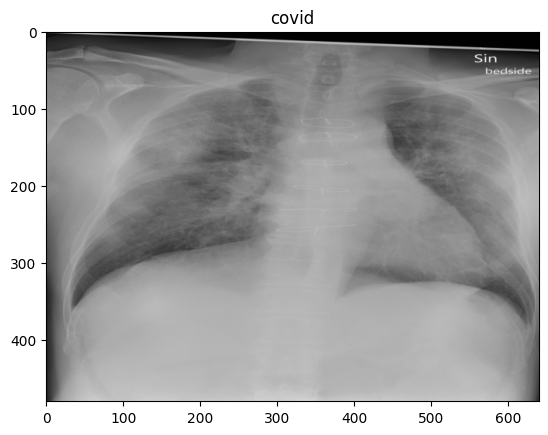

In [ ]:
# Determine covid class.
ClassPath = os.path.join(train_path, "covid")
# Select random image of this set.
Random_Image = os.path.join(ClassPath, np.random.choice(os.listdir(ClassPath)))
# Read the image.
image = plt.imread(Random_Image)

# Creating a dataset which contains just one image.
test_augment_image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))

plt.imshow(test_augment_image[0])
plt.title('covid')
plt.show()

#### **Applying selected augmentations**

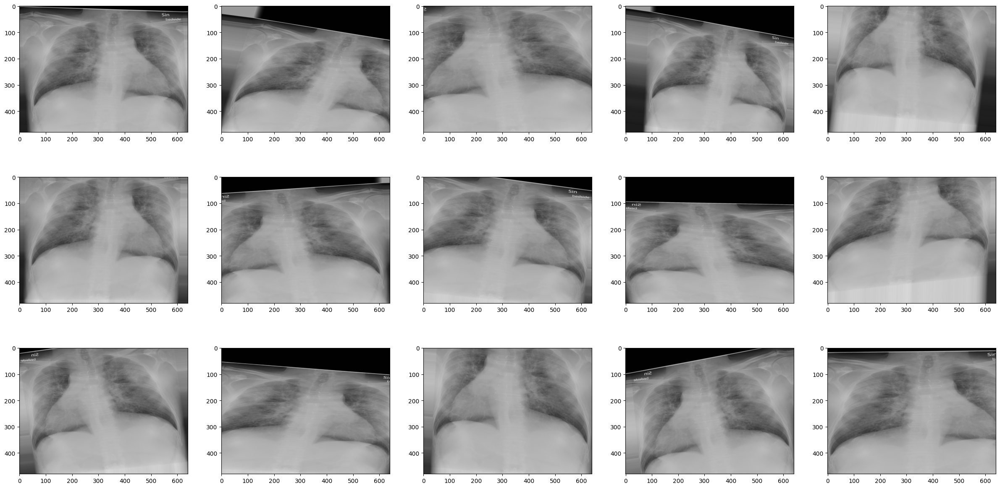

In [ ]:
# Applying data augmentation on one image only.
image_preprocessor = ImageDataGenerator(
                                        zoom_range = (0.8, 1.2),
                                        rotation_range = 10,                                        
                                        width_shift_range = 0.1,
                                        height_shift_range = 0.1,
                                        shear_range = 10,
                                        horizontal_flip = True,
                                        fill_mode = 'nearest'
                                        )

plot_norm_aug(image_preprocessor, test_augment_image, 3, 5)

**Discussion Stage**
* Data Augmentation will help a lot when training the model in reducing the effect of overfitting causing by due to the small size of the data.
* I used a different and variant range of it and address the best.

### Applying Data Augmentation on the full data set

In [ ]:
# Choose batch size.
BATCH_SIZE = 32
# Apply and create new augmented splites.
training_set, validation_set, test_set = create_augmented_splites(train_dataframe, validation_dataframe, test_dataframe, train_path, BATCH_SIZE, (FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2))

Found 956 validated image filenames belonging to 3 classes.
Found 120 validated image filenames belonging to 3 classes.
Found 120 validated image filenames belonging to 3 classes.


#### Ensure data augmention process.

**Ensure the process of training data augmentation**

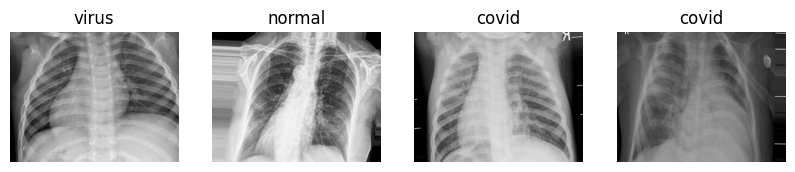

In [ ]:
sample_training_data = training_set.__getitem__(0)[0]
sample_training_label = training_set.__getitem__(0)[1]

plt.figure(figsize=(10, 10))
for index in range(4):
    plt.subplot(1, 4, index + 1)
    plt.axis('off')
    plt.imshow(sample_training_data[index])
    plt.title(classes[np.argmax(sample_training_label[index])])

**Ensure validation data augmentation**

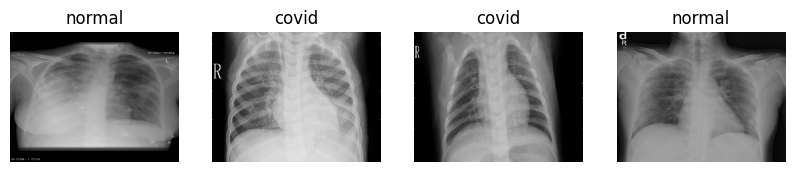

In [ ]:
sample_validation_data = validation_set.__getitem__(0)[0]
sample_validation_label = validation_set.__getitem__(0)[1]

plt.figure(figsize=(10, 10))
for index in range(4):
    plt.subplot(1, 4, index + 1)
    plt.axis('off')
    plt.imshow(sample_validation_data[index])
    plt.title(classes[np.argmax(sample_validation_label[index])])

**Ensure test data augmentation**

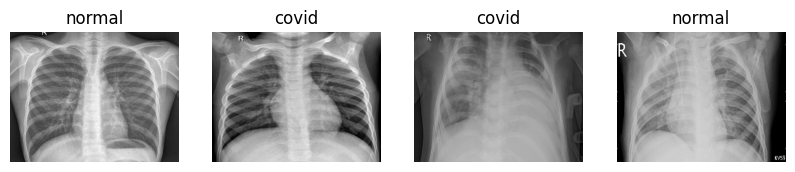

In [ ]:
sample_test_data = test_set.__getitem__(0)[0]
sample_test_label = test_set.__getitem__(0)[1]

plt.figure(figsize=(10, 10))
for index in range(4):
    plt.subplot(1, 4, index + 1)
    plt.axis('off')
    plt.imshow(sample_test_data[index])
    plt.title(classes[np.argmax(sample_validation_label[index])])

**Discussion Stage**
* The data has been split, and all the splits have the same preprocessing done using Data Generators.

#### **Checking generators with images arrays**


In [ ]:
training_set[1][0][-1]

array([[[0.21960786, 0.21960786, 0.21960786],
        [0.21960786, 0.21960786, 0.21960786],
        [0.21960786, 0.21960786, 0.21960786],
        ...,
        [0.09411766, 0.09411766, 0.09411766],
        [0.09952963, 0.09952963, 0.09952963],
        [0.10395911, 0.10395911, 0.10395911]],

       [[0.21199656, 0.21199656, 0.21199656],
        [0.21294811, 0.21294811, 0.21294811],
        [0.21389967, 0.21389967, 0.21389967],
        ...,
        [0.09411766, 0.09411766, 0.09411766],
        [0.10058361, 0.10058361, 0.10058361],
        [0.10360779, 0.10360779, 0.10360779]],

       [[0.22587337, 0.22587337, 0.22587337],
        [0.22730072, 0.22730072, 0.22730072],
        [0.22574823, 0.22574823, 0.22574823],
        ...,
        [0.09411766, 0.09411766, 0.09411766],
        [0.10163757, 0.10163757, 0.10163757],
        [0.10325646, 0.10325646, 0.10325646]],

       ...,

       [[0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        [0.        , 0

[0. 1. 0.]


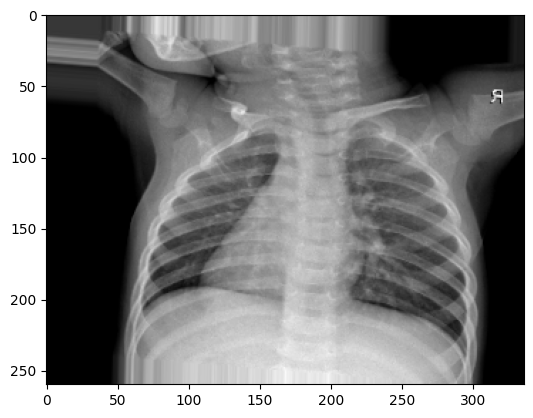

In [ ]:
plt.imshow(training_set[1][0][-1])
print(training_set[1][1][-1])

[1. 0. 0.]


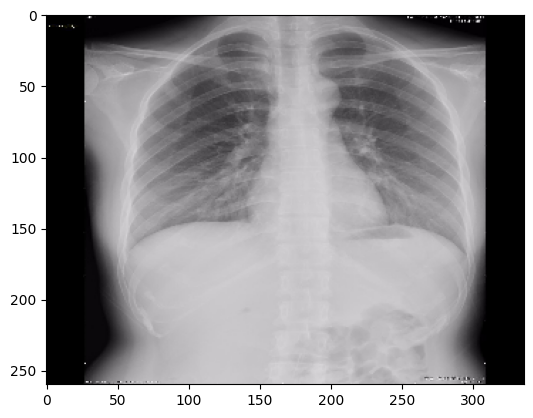

In [ ]:
plt.imshow(validation_set[1][0][-1])
print(validation_set[1][1][-1])

In [ ]:
test_set[0][0][0]

array([[[0.15294118, 0.15294118, 0.15294118],
        [0.15294118, 0.15294118, 0.15294118],
        [0.14901961, 0.14901961, 0.14901961],
        ...,
        [0.15686275, 0.15686275, 0.15686275],
        [0.16078432, 0.16078432, 0.16078432],
        [0.17254902, 0.17254902, 0.17254902]],

       [[0.14901961, 0.14901961, 0.14901961],
        [0.15686275, 0.15686275, 0.15686275],
        [0.15686275, 0.15686275, 0.15686275],
        ...,
        [0.16470589, 0.16470589, 0.16470589],
        [0.14509805, 0.14509805, 0.14509805],
        [0.16470589, 0.16470589, 0.16470589]],

       [[0.13725491, 0.13725491, 0.13725491],
        [0.16078432, 0.16078432, 0.16078432],
        [0.15686275, 0.15686275, 0.15686275],
        ...,
        [0.16862746, 0.16862746, 0.16862746],
        [0.17254902, 0.17254902, 0.17254902],
        [0.15686275, 0.15686275, 0.15686275]],

       ...,

       [[0.15294118, 0.15294118, 0.15294118],
        [0.14509805, 0.14509805, 0.14509805],
        [0.14117648, 0

[0. 1. 0.]


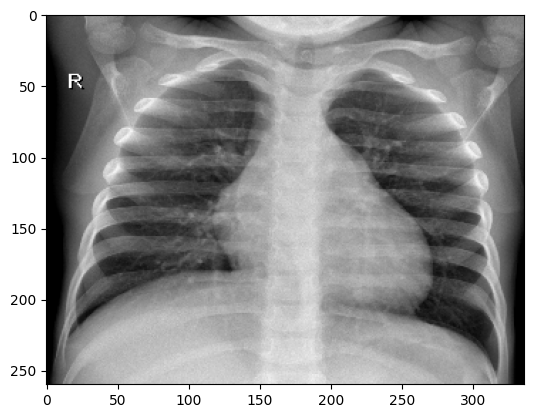

In [ ]:
plt.imshow(test_set[0][0][-1])
print(test_set[0][1][-1])

In [ ]:
test_set[3][0][-1]

array([[[0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        ...,
        [0.63529414, 0.63529414, 0.63529414],
        [0.627451  , 0.627451  , 0.627451  ],
        [0.627451  , 0.627451  , 0.627451  ]],

       [[0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        ...,
        [0.60784316, 0.60784316, 0.60784316],
        [0.6156863 , 0.6156863 , 0.6156863 ],
        [0.6156863 , 0.6156863 , 0.6156863 ]],

       [[0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        ...,
        [0.5921569 , 0.5921569 , 0.5921569 ],
        [0.61960787, 0.61960787, 0.61960787],
        [0.627451  , 0.627451  , 0.627451  ]],

       ...,

       [[0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        ],
        [0.        , 0

[1. 0. 0.]


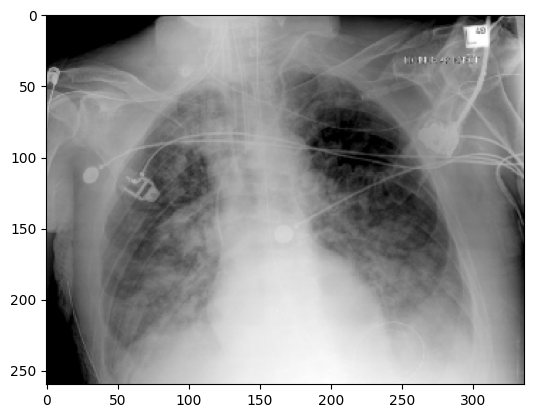

In [ ]:
plt.imshow(test_set[3][0][-1])
print(test_set[3][1][-1])

**Diacussion Stage**
* We Notice that all the images now are represented as gray scale float arrays (normalized images)

# Modelling

## **Build essantial functions**

In [ ]:
def plot_acc_loss_curves(history):
  '''
  This function visualises accuracy and loss scores and plot it.
  Args: history indicates training and validation accuracy and loss history.
  Returns: plot a visualise of accuracy and loss curves.
  '''
  loss = history.history["loss"]
  val_loss = history.history["val_loss"]

  accuracy = history.history["accuracy"]
  val_accuracy = history.history["val_accuracy"]

  epochs = range(len(history.history["loss"]))

  plt.figure(figsize=(15, 5))
  plt.style.use('ggplot')
  plt.rcParams['figure.figsize'] = [16, 5]
  plt.rcParams['font.size'] = 14
  plt.rcParams['axes.grid'] = True
  plt.rcParams['figure.facecolor'] = 'white'

  # plot loss
  plt.subplot(1, 2, 1)
  plt.plot(loss, label = 'Training Loss')
  plt.plot(val_loss, label = 'Validation Loss')
  plt.legend()
  plt.ylabel('Cross Entropy')
  plt.title(f'Training and Validation Loss. \nTrain Loss: {str(loss[-1])}\nValidation Loss: {str(val_loss[-1])}')
  plt.xlabel('Epoch')

  # plot accuracy
  plt.subplot(1, 2, 2)
  plt.plot(accuracy, label = 'Training Accuracy')
  plt.plot(val_accuracy, label = 'Validation Accuracy')
  plt.legend()
  plt.ylabel('Accuracy')
  plt.xlabel('Epoch')
  plt.title(f'\nTraining and Validation Accuracy. \nTrain Accuracy: {(str(accuracy[-1]))} \nValidation Accuracy: {str(val_accuracy[-1])}')
  return plt.show()

In [ ]:
def model_predictions_map(test_set, CNN_Model, batch_size, N_Classes):
  '''
  This function visualises prediction scores of test set using one CNN model.
  Args: test_set indicates test set we want to predict.
        CNN_Model indicates model we want to use for data prediction.
        N_Classes indicates the count of data classes.
        batch_size indicates the batch size of the model.
  Returns: visualize prediction scores of each image from 0 random pictures
  '''
  N_Classes = list(N_Classes.values())
  # Display 10 random pictures from the dataset with their labels

  Random_batch = np.random.randint(0, len(test_set))

  Random_Img_Index = np.random.randint(0, batch_size , 10)

  fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(25, 10),
                          subplot_kw={'xticks': [], 'yticks': []})

  for i, ax in enumerate(axes.flat):

      Random_Img = test_set[Random_batch][0][Random_Img_Index[i]]

      Random_Img_Label = np.argmax(test_set[Random_batch][1][Random_Img_Index[i]])

      Model_Predictions = CNN_Model.predict( tf.expand_dims(Random_Img, axis=0) , verbose=0)
    
      Model_Highest_Prediction = np.argmax(Model_Predictions)  
      
      Model_Predictions_Map = { c: round(p*100,3) for (c,p) in zip (N_Classes, Model_Predictions.tolist()[0] ) }

      ax.imshow(Random_Img)

      Pred_Class = N_Classes[Model_Highest_Prediction]

      if N_Classes[Random_Img_Label] == Pred_Class:
        color = "green"
      else:
        color = "red"
      ax.set_title(f"True: {N_Classes[Random_Img_Label]}\nPredicted: {Pred_Class}\nConfidence: {Model_Predictions_Map[Pred_Class]}%",
            color=color)
      print(Model_Predictions_Map)
  plt.show()
  plt.tight_layout()

In [ ]:
def evaluate_model_cr(model_name, model, val_data, val_label, batch_size, N_Classes):
  '''
  This function evaluate the model using classification report.
  Args: model_name - indicates the model name.
        model - indicates model we want to use for data prediction.
        val_data - indicates the validation data.
        val_label - indicates the validation labels.
        batch_size - indicates batch size.
  Returns: an evaluate of the model using classification report.
  '''
  N_Classes = list(N_Classes.values())
  # make predictions on the testing set
  print(f"Evaluating {model_name} network ...")
  predIdxs = model.predict(val_data, batch_size= BATCH_SIZE)
  # for each image in the testing set we need to find the index of the
  # label with corresponding largest predicted probability
  predIdxs = np.argmax(predIdxs, axis=1)
  # show a nicely formatted classification report
  return (classification_report(val_label, list(predIdxs), target_names= N_Classes))

In [ ]:
def evaluate_model_cmr(model_name, model, val_data, val_label, batch_size, N_Classes):
  '''
  This function evaluate the model using confusion matrix.
  Args: model_name - indicates the model name.
        model - indicates model we want to use for data prediction.
        val_data - indicates the validation data.
        val_label - indicates the validation labels.
        batch_size - indicates batch size.
  Returns: an evaluate of the model using confusion matrix.
  '''
  N_Classes = list(N_Classes.values())
  fig, ax= plt.subplots(figsize=(5,5))
  # make predictions on the testing set
  print(f"Evaluating {model_name} network using confusion matrix ...")
  predIdxs = model.predict(val_data, batch_size= BATCH_SIZE)
  # for each image in the testing set we need to find the index of the
  # label with corresponding largest predicted probability
  predIdxs = np.argmax(predIdxs, axis=1)
  # show a nicely formatted confusion matrix
  cm_arr = confusion_matrix(val_label, list(predIdxs))
  arr_df = pd.DataFrame(cm_arr)
  sns.heatmap(arr_df, annot=True, fmt='g', ax = ax)
  ax.set_xlabel('Predicted labels',fontsize=15, fontweight='bold')
  ax.set_ylabel('True labels', fontsize=15, fontweight='bold')
  ax.set_title(f'{model_name} Confusion Matrix', fontsize=20, fontweight='bold')

  ax.set_xticklabels(N_Classes , fontsize=15)
  ax.set_yticklabels(N_Classes, rotation=0, fontsize=15)
  return plt.show()

### **Prepare test images**

In [ ]:
# test_images_data = []
# for img_name in validation_dataframe["Image"]:
#     img = os.path.join(img_name)
#     img = cv2.imread(img, cv2.IMREAD_COLOR)
#     img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
#     img = x = cv2.resize(img, (FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2))
#     img = np.expand_dims(img, axis=0)
#     img = img / 255.
#     test_images_data.append(img)
# images = np.vstack(test_images_data)

## Best Match CNN

### Create CallBacks

In [ ]:
# Define Learning Rate schedule.
initial_learning_rate = 0.0001
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps= 3,
    decay_rate=0.16,
    staircase=True)

In [ ]:
# def get_f1(y_true, y_pred): #taken from old keras source code
#     true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
#     possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
#     predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
#     precision = true_positives / (predicted_positives + K.epsilon())
#     recall = true_positives / (possible_positives + K.epsilon())
#     f1_val = 2*(precision*recall)/(precision+recall+K.epsilon())
#     return f1_val

**Discussion Stage**
* I tried to use f1 weighted score through the fitting progress of the loss compute, but after some experiments I get back to the default fitting case.

In [ ]:
early_stop = tf.keras.callbacks.EarlyStopping(patience = 5,
                                              min_delta = 1e-7,
                                              restore_best_weights=True
                                             )
# reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(
#                                                  factor=0.2, 
#                                                  patience=5, 
#                                                  min_lr=0.001
#                                                 )

In [ ]:
# Apply learning rate scheduler.
reduce_lr = tf.keras.callbacks.LearningRateScheduler(lr_schedule)

**Discussion Stage**
* I used several callback types and address the best of it, with the best hyperparameters.

In [ ]:
# # Create Callback Checkpoint.
# checkpoint_path = "Model_Checkpoint.h5"

# Checkpoint = ModelCheckpoint(checkpoint_path, monitor = "val_accuracy", save_best_only=True)

In [ ]:
callbacks = [early_stop, reduce_lr]

In [ ]:
# Number of steps in training and validation sets.
STEP_SIZE_TRAIN = training_set.n // training_set.batch_size
STEP_SIZE_VALID = validation_set.n // validation_set.batch_size
# Number of epochs.
epochs = 30
# Number of classes.
n_classes = len(reverse_mapping)

### **DenseNet**

**Complete DenseNet 121 architecture:**

In [ ]:
# Creating Densenet121
def densenet(input_shape, n_classes, filters = 32):
    
  # batch norm + relu + conv
  def bn_rl_conv(x,filters,kernel=1,strides=1):
      
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.ReLU()(x)
    x = tf.keras.layers.Conv2D(filters, kernel, strides=strides,padding = 'same')(x)
    return x

  def dense_block(x, repetition):
      
      for _ in range(repetition):
          y = bn_rl_conv(x, 4*filters)
          y = bn_rl_conv(y, filters, 3)
          x = tf.keras.layers.concatenate([y,x])
      return x
      
  def transition_layer(x):
      
      x = bn_rl_conv(x, K.int_shape(x)[-1] //2 )
      x = tf.keras.layers.AvgPool2D(2, strides = 2, padding = 'same')(x)
      return x

  input = tf.keras.layers.Input(input_shape)
  x = tf.keras.layers.Conv2D(64, 7, strides = 2, padding = 'same')(input)
  x = tf.keras.layers.MaxPool2D(3, strides = 2, padding = 'same')(x)

  for repetition in [6,12,24,16]:
      
      d = dense_block(x, repetition)
      x = transition_layer(d)    
  x = tf.keras.layers.GlobalAveragePooling2D()(d)
  output = tf.keras.layers.Dense(n_classes, activation = 'softmax')(x)

  model = tf.keras.models.Model(input, output)
  return model
input_shape = FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2, 3
n_classes = n_classes
densenet_model = densenet(input_shape, n_classes)
# Plot model summary.
densenet_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 260, 336, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 130, 168, 64  9472        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 max_pooling2d (MaxPooling2D)   (None, 65, 84, 64)   0           ['conv2d[0][0]']                 
                                                                                              

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.700524 to fit



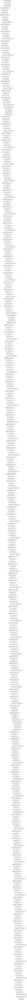

In [ ]:
# Plot model summary.
tf.keras.utils.plot_model(densenet_model, show_shapes=True)

**Compile and fit the mode**

In [ ]:
densenet_model.compile(optimizer= tf.keras.optimizers.experimental.AdamW(), loss='categorical_crossentropy', metrics=['accuracy'])

**Discussion Stage**
* I tried different optimizer algorithms, but after research and experimentation I found that AdamW is the best choice, and this is the same of the subsequent algorithms.

In [ ]:
# Fit the model.
densenet_model_history = densenet_model.fit(training_set,
                    steps_per_epoch = STEP_SIZE_TRAIN,
                    validation_data = validation_set,
                    validation_steps = STEP_SIZE_VALID,
                    epochs = epochs,
                    class_weight = class_weights,
                    callbacks = callbacks
)

Epoch 1/30
29/29 [==============================] - 137s 1s/step - loss: 0.3770 - accuracy: 0.8593 - val_loss: 1.5740 - val_accuracy: 0.3750 - lr: 1.0000e-04
Epoch 2/30
29/29 [==============================] - 41s 1s/step - loss: 0.2896 - accuracy: 0.8950 - val_loss: 2.1184 - val_accuracy: 0.3750 - lr: 1.0000e-04
Epoch 3/30
29/29 [==============================] - 42s 1s/step - loss: 0.2093 - accuracy: 0.9253 - val_loss: 3.3347 - val_accuracy: 0.3750 - lr: 1.0000e-04
Epoch 4/30
29/29 [==============================] - 41s 1s/step - loss: 0.1661 - accuracy: 0.9394 - val_loss: 4.2026 - val_accuracy: 0.3750 - lr: 1.6000e-05
Epoch 5/30
29/29 [==============================] - 41s 1s/step - loss: 0.1514 - accuracy: 0.9437 - val_loss: 4.4884 - val_accuracy: 0.3750 - lr: 1.6000e-05
Epoch 6/30
29/29 [==============================] - 42s 1s/step - loss: 0.1423 - accuracy: 0.9416 - val_loss: 4.6297 - val_accuracy: 0.3750 - lr: 1.6000e-05


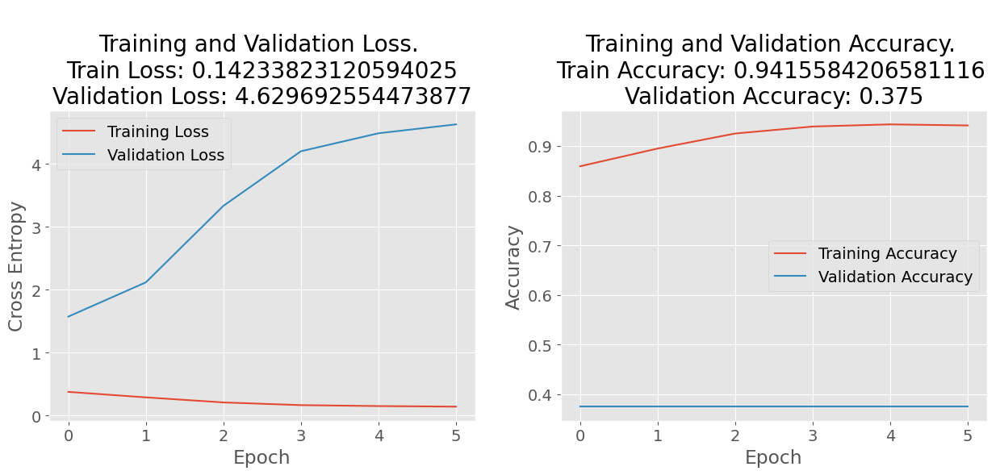

In [ ]:
# Visualize accuracy and loss curves.
plot_acc_loss_curves(densenet_model_history)

In [ ]:
# Visualize classification report.
print(evaluate_model_cr("Dense Net Classic CNN", densenet_model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping))

Evaluating Dense Net Classic CNN network ...
4/4 [==============================] - 5s 527ms/step
              precision    recall  f1-score   support

       covid       0.00      0.00      0.00        30
      normal       0.00      0.00      0.00        47
       virus       0.36      1.00      0.53        43

    accuracy                           0.36       120
   macro avg       0.12      0.33      0.18       120
weighted avg       0.13      0.36      0.19       120



/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Evaluating Dense Net Classic CNN network using confusion matrix ...
4/4 [==============================] - 2s 482ms/step


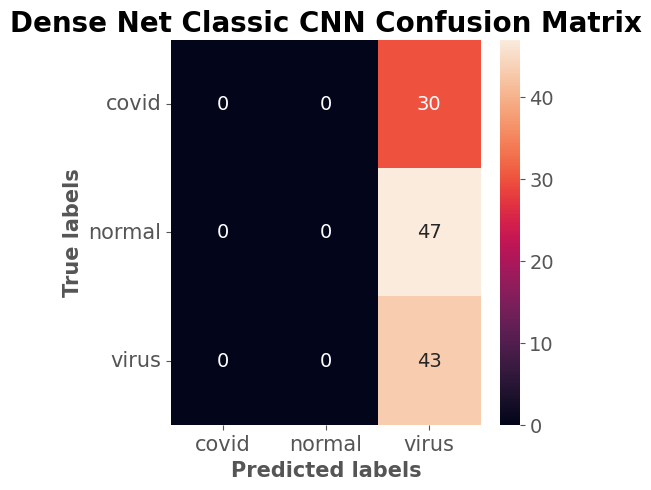

In [ ]:
# Visualize confusion matrix report.
evaluate_model_cmr("Dense Net Classic CNN", densenet_model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping)

{'covid': 2.706, 'normal': 15.849, 'virus': 81.445}
{'covid': 3.16, 'normal': 19.588, 'virus': 77.252}
{'covid': 3.01, 'normal': 12.119, 'virus': 84.871}
{'covid': 2.488, 'normal': 8.684, 'virus': 88.828}
{'covid': 4.1, 'normal': 22.673, 'virus': 73.228}
{'covid': 3.083, 'normal': 14.128, 'virus': 82.79}
{'covid': 2.713, 'normal': 15.679, 'virus': 81.607}
{'covid': 3.01, 'normal': 12.119, 'virus': 84.871}
{'covid': 2.713, 'normal': 15.679, 'virus': 81.607}
{'covid': 3.588, 'normal': 20.92, 'virus': 75.492}


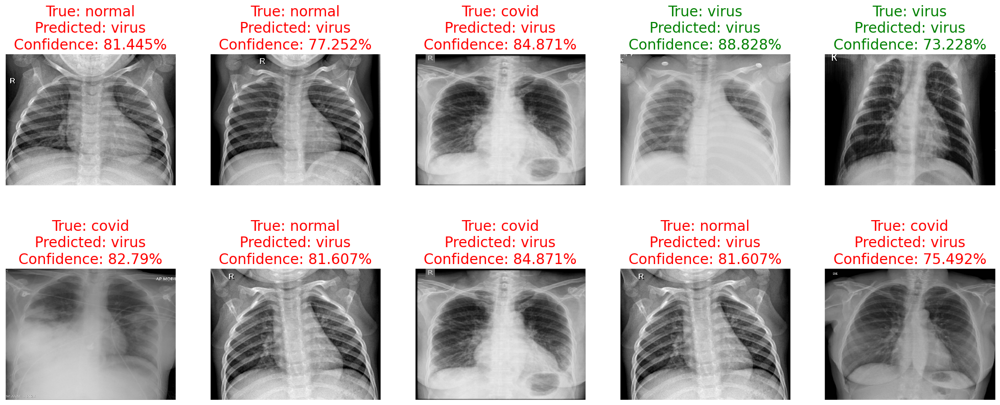

<Figure size 1600x500 with 0 Axes>

In [ ]:
# Predict test set and visualize the prediction probabilities.
model_predictions_map(test_set, densenet_model, BATCH_SIZE, reverse_mapping)

### **Complete VGG architecture**

In [ ]:
vgg_model = tf.keras.models.Sequential()
# The first part has two conv64 with a pooling layer
vgg_model.add(tf.keras.layers.Conv2D(input_shape=(FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2, 3),filters=64,kernel_size=(3,3),padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.Conv2D(filters=64,kernel_size=(3,3),padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
# The second part has two conv128 with a pooling layer
vgg_model.add(tf.keras.layers.Conv2D(filters=128, kernel_size=(3,3), padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.Conv2D(filters=128, kernel_size=(3,3), padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
# The Third part has three conv256 with a pooling layer
vgg_model.add(tf.keras.layers.Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
# The fourth part has four conv512 with a pooling layer
vgg_model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
# The fifth part has four conv512 with a pooling layer
vgg_model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
vgg_model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
# At last, We have Two Dense layers with 4096 nodes and an output layer
vgg_model.add(tf.keras.layers.Flatten())
vgg_model.add(tf.keras.layers.Dense(units=4096,activation="relu"))
vgg_model.add(tf.keras.layers.Dense(units=4096,activation="relu"))
# units are 3 because we are using multiclass activation
vgg_model.add(tf.keras.layers.Dense(units= n_classes, activation="softmax"))
# Plot model summary.
vgg_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_121 (Conv2D)         (None, 260, 336, 64)      1792      
                                                                 
 conv2d_122 (Conv2D)         (None, 260, 336, 64)      36928     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 130, 168, 64)     0         
 2D)                                                             
                                                                 
 conv2d_123 (Conv2D)         (None, 130, 168, 128)     73856     
                                                                 
 conv2d_124 (Conv2D)         (None, 130, 168, 128)     147584    
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 65, 84, 128)      0         
 2D)                                                    

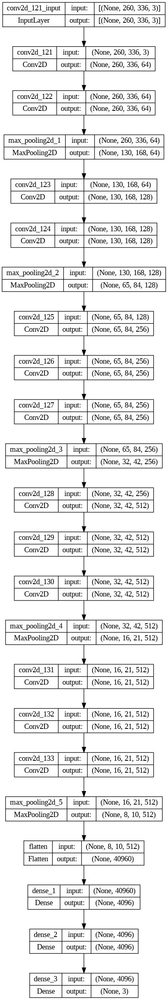

In [ ]:
# Plot model summary.
tf.keras.utils.plot_model(vgg_model, show_shapes=True)

**Compile and fit the mode**

In [ ]:
vgg_model.compile(optimizer= tf.keras.optimizers.experimental.AdamW(), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
# Fit the model
vgg_model_history = vgg_model.fit(training_set,
                    steps_per_epoch = STEP_SIZE_TRAIN,
                    validation_data = validation_set,
                    validation_steps = STEP_SIZE_VALID,
                    epochs = epochs,
                    class_weight = class_weights,
                    callbacks = callbacks
)

Epoch 1/30
29/29 [==============================] - 85s 2s/step - loss: 0.9817 - accuracy: 0.4654 - val_loss: 0.8296 - val_accuracy: 0.6562 - lr: 1.0000e-04
Epoch 2/30
29/29 [==============================] - 44s 1s/step - loss: 0.7690 - accuracy: 0.5931 - val_loss: 0.7372 - val_accuracy: 0.7604 - lr: 1.0000e-04
Epoch 3/30
29/29 [==============================] - 43s 1s/step - loss: 0.6563 - accuracy: 0.6861 - val_loss: 0.5742 - val_accuracy: 0.8542 - lr: 1.0000e-04
Epoch 4/30
29/29 [==============================] - 45s 2s/step - loss: 0.4892 - accuracy: 0.7781 - val_loss: 0.5721 - val_accuracy: 0.8750 - lr: 1.6000e-05
Epoch 5/30
29/29 [==============================] - 44s 2s/step - loss: 0.4432 - accuracy: 0.7911 - val_loss: 0.5545 - val_accuracy: 0.8854 - lr: 1.6000e-05
Epoch 6/30
29/29 [==============================] - 44s 1s/step - loss: 0.4073 - accuracy: 0.8139 - val_loss: 0.5338 - val_accuracy: 0.8750 - lr: 1.6000e-05
Epoch 7/30
29/29 [==============================] - 43s 1s

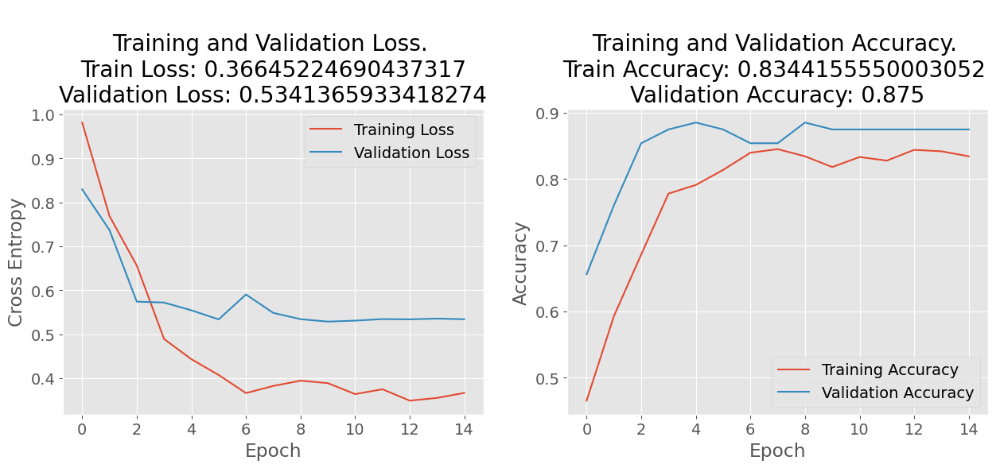

In [ ]:
# Visualize accurecy and loss curves.
plot_acc_loss_curves(vgg_model_history)

Evaluating VGG Classic CNN network using confusion matrix ...
4/4 [==============================] - 8s 2s/step


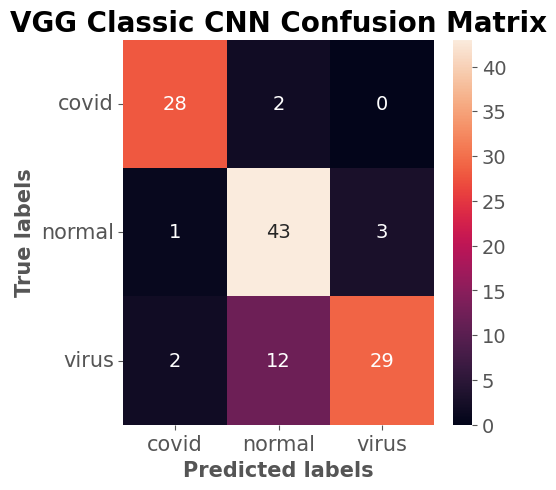

In [ ]:
# Visualize confusion matrix report.
evaluate_model_cmr("VGG Classic CNN", vgg_model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping)

In [ ]:
# Visualize classification report.
print(evaluate_model_cr("VGG Classic CNN", vgg_model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping))

Evaluating VGG Classic CNN network ...
4/4 [==============================] - 2s 481ms/step
              precision    recall  f1-score   support

       covid       0.90      0.93      0.92        30
      normal       0.75      0.91      0.83        47
       virus       0.91      0.67      0.77        43

    accuracy                           0.83       120
   macro avg       0.85      0.84      0.84       120
weighted avg       0.85      0.83      0.83       120



{'covid': 99.566, 'normal': 0.296, 'virus': 0.138}
{'covid': 0.576, 'normal': 97.816, 'virus': 1.608}
{'covid': 0.198, 'normal': 91.224, 'virus': 8.578}
{'covid': 0.198, 'normal': 91.224, 'virus': 8.578}
{'covid': 0.074, 'normal': 70.589, 'virus': 29.337}
{'covid': 93.143, 'normal': 6.459, 'virus': 0.398}
{'covid': 0.126, 'normal': 94.759, 'virus': 5.114}
{'covid': 0.753, 'normal': 97.655, 'virus': 1.592}
{'covid': 0.073, 'normal': 63.812, 'virus': 36.115}
{'covid': 0.032, 'normal': 18.764, 'virus': 81.205}


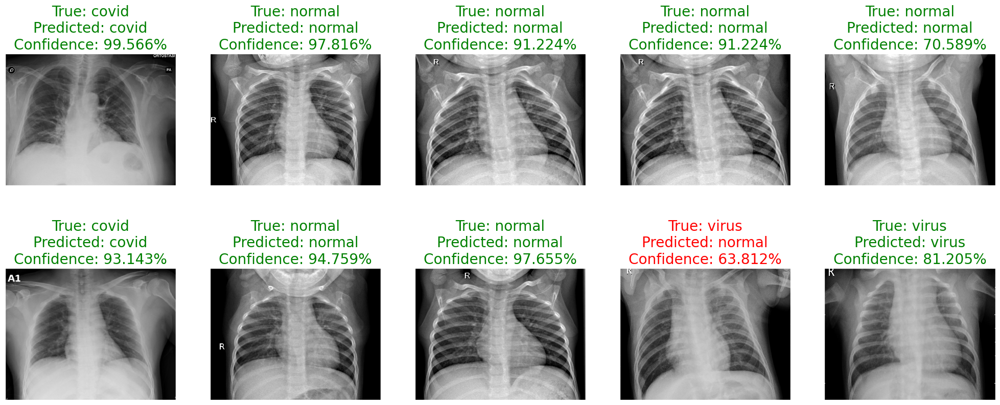

<Figure size 1600x500 with 0 Axes>

In [ ]:
# Predict test set and visualize the prediction probabilities.
model_predictions_map(test_set, vgg_model, BATCH_SIZE, reverse_mapping)

## Custom CNN

### **Custom CNN without BatchNormalization**

In [ ]:
classic_model_without_BN = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(8, (3, 3), padding='same', activation='relu', kernel_initializer="he_normal", input_shape=(FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2, 3)),

    tf.keras.layers.Conv2D(16, (3, 3), padding='same', kernel_initializer="he_normal", activation='relu'),
    tf.keras.layers.AveragePooling2D(),

    tf.keras.layers.Conv2D(32, (3, 3), padding="same", kernel_initializer="he_normal", activation='relu'),
    tf.keras.layers.MaxPooling2D(),

    tf.keras.layers.Conv2D(64, (3, 3), padding="same", kernel_initializer="he_normal", activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Dropout(0.25),

    tf.keras.layers.Conv2D(128, (3, 3), padding="same", kernel_initializer="he_normal", activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Dropout(0.25),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(64, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dense(n_classes, activation = 'softmax', kernel_initializer="GlorotUniform"),
])
# Plot model summary.
classic_model_without_BN.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_134 (Conv2D)         (None, 260, 336, 8)       224       
                                                                 
 conv2d_135 (Conv2D)         (None, 260, 336, 16)      1168      
                                                                 
 average_pooling2d_4 (Averag  (None, 130, 168, 16)     0         
 ePooling2D)                                                     
                                                                 
 conv2d_136 (Conv2D)         (None, 130, 168, 32)      4640      
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 65, 84, 32)       0         
 2D)                                                             
                                                                 
 conv2d_137 (Conv2D)         (None, 65, 84, 64)       

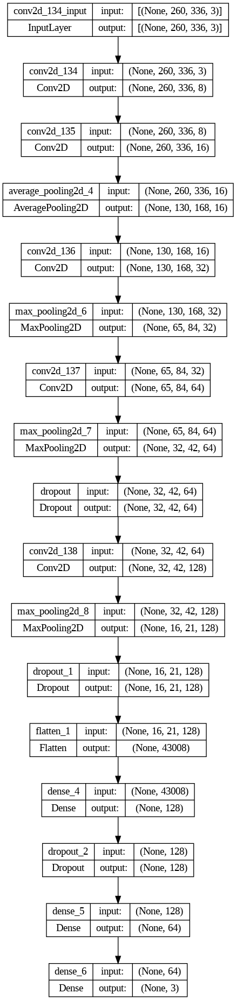

In [ ]:
# Plot model summary.
tf.keras.utils.plot_model(classic_model_without_BN, show_shapes=True)

**Compile and fit the mode**

In [ ]:
classic_model_without_BN.compile(optimizer= tf.keras.optimizers.experimental.AdamW(), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
# Fit the model
classic_model_without_BN_history = classic_model_without_BN.fit(training_set,
                    steps_per_epoch = STEP_SIZE_TRAIN,
                    validation_data = validation_set,
                    validation_steps = STEP_SIZE_VALID,
                    epochs = epochs,
                    class_weight = class_weights,
                    callbacks = callbacks
)

Epoch 1/30
29/29 [==============================] - 43s 1s/step - loss: 2.4456 - accuracy: 0.3922 - val_loss: 0.9447 - val_accuracy: 0.5625 - lr: 1.0000e-04
Epoch 2/30
29/29 [==============================] - 38s 1s/step - loss: 0.9898 - accuracy: 0.4946 - val_loss: 0.8946 - val_accuracy: 0.5729 - lr: 1.0000e-04
Epoch 3/30
29/29 [==============================] - 37s 1s/step - loss: 0.8966 - accuracy: 0.5238 - val_loss: 0.9302 - val_accuracy: 0.4792 - lr: 1.0000e-04
Epoch 4/30
29/29 [==============================] - 38s 1s/step - loss: 0.8494 - accuracy: 0.5357 - val_loss: 0.9068 - val_accuracy: 0.5312 - lr: 1.6000e-05
Epoch 5/30
29/29 [==============================] - 36s 1s/step - loss: 0.8126 - accuracy: 0.5649 - val_loss: 0.9133 - val_accuracy: 0.5521 - lr: 1.6000e-05
Epoch 6/30
29/29 [==============================] - 36s 1s/step - loss: 0.7953 - accuracy: 0.5758 - val_loss: 0.8814 - val_accuracy: 0.5625 - lr: 1.6000e-05
Epoch 7/30
29/29 [==============================] - 36s 1s

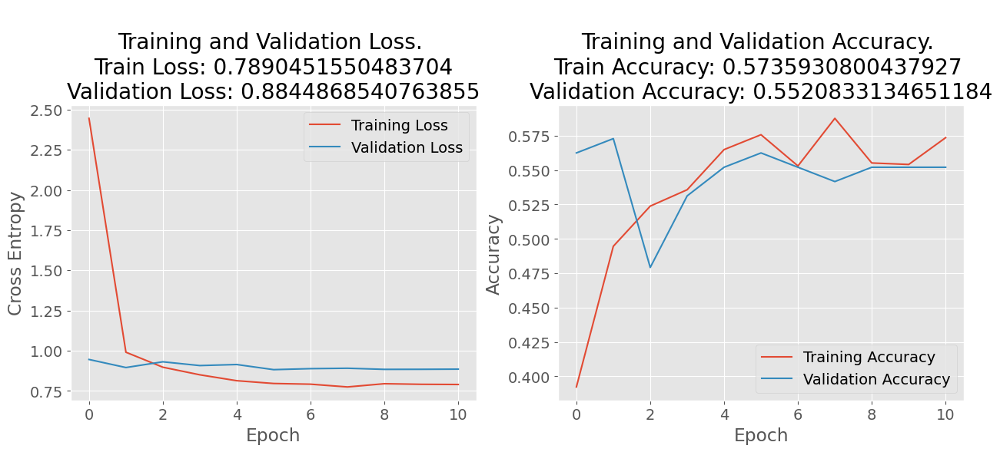

In [ ]:
# Visualize accurecy and loss curves.
plot_acc_loss_curves(classic_model_without_BN_history)

**Discussion Stage**
* Here we can notice that there is no overfit.

Evaluating Classic Model without BatchNormalization network using confusion matrix ...
4/4 [==============================] - 2s 610ms/step


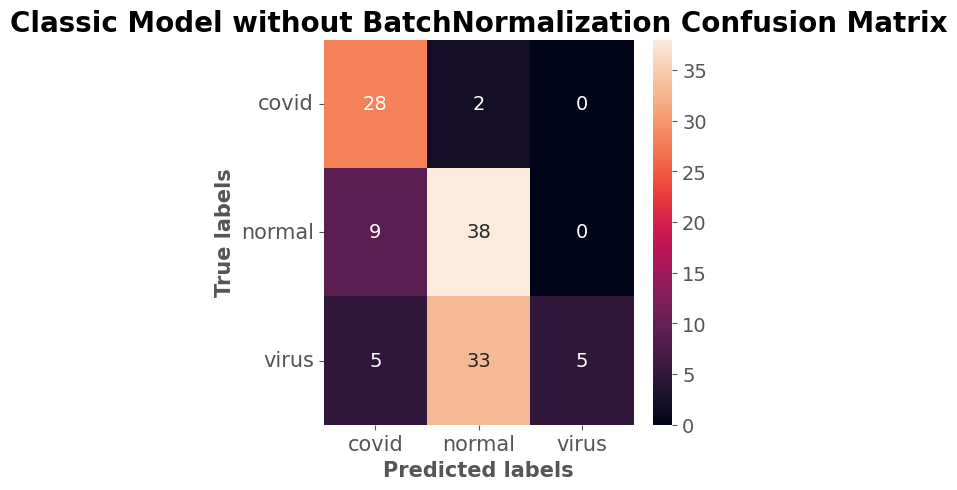

In [ ]:
# Visualize confusion matrix report.
evaluate_model_cmr("Classic Model without BatchNormalization", classic_model_without_BN, test_set, test_set.labels, BATCH_SIZE, reverse_mapping)

In [ ]:
# Visualize classification report.
print(evaluate_model_cr("Classic Model without BatchNormalization", classic_model_without_BN, test_set, test_set.labels, BATCH_SIZE, reverse_mapping))

Evaluating Classic Model without BatchNormalization network ...
4/4 [==============================] - 2s 431ms/step
              precision    recall  f1-score   support

       covid       0.67      0.93      0.78        30
      normal       0.52      0.81      0.63        47
       virus       1.00      0.12      0.21        43

    accuracy                           0.59       120
   macro avg       0.73      0.62      0.54       120
weighted avg       0.73      0.59      0.52       120



{'covid': 19.356, 'normal': 40.867, 'virus': 39.777}
{'covid': 36.912, 'normal': 35.225, 'virus': 27.863}
{'covid': 21.344, 'normal': 39.444, 'virus': 39.212}
{'covid': 17.2, 'normal': 43.006, 'virus': 39.794}
{'covid': 18.759, 'normal': 42.468, 'virus': 38.773}
{'covid': 87.896, 'normal': 6.723, 'virus': 5.381}
{'covid': 26.211, 'normal': 38.594, 'virus': 35.195}
{'covid': 17.2, 'normal': 43.006, 'virus': 39.794}
{'covid': 23.348, 'normal': 38.093, 'virus': 38.558}
{'covid': 31.533, 'normal': 32.981, 'virus': 35.486}


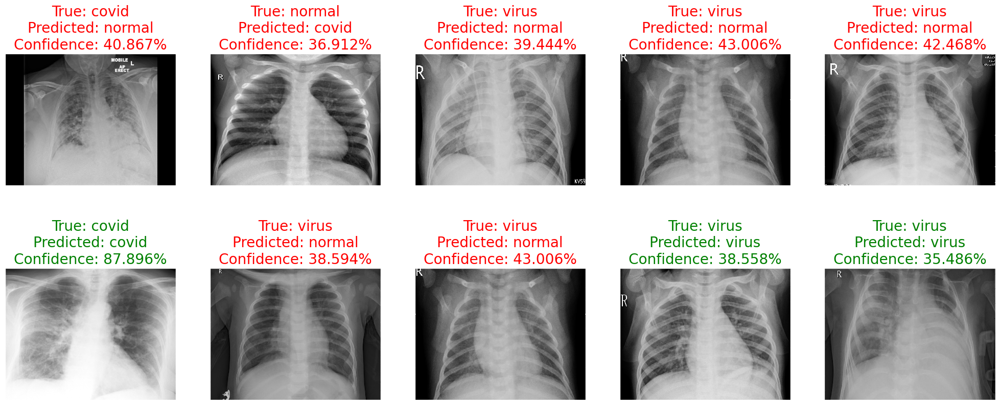

<Figure size 1600x500 with 0 Axes>

In [ ]:
# Predict test set and visualize the prediction probabilities.
model_predictions_map(test_set, classic_model_without_BN, BATCH_SIZE, reverse_mapping)

### **Custom CNN with BatchNormalization**

In [ ]:
# classic_model_BN = tf.keras.models.Sequential()

# classic_model_BN.add(tf.keras.layers.Conv2D(filters=32, kernel_size=(3, 3), input_shape = (FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2, 3), activation='relu', use_bias = False))
# classic_model_BN.add(tf.keras.layers.BatchNormalization())
# classic_model_BN.add(tf.keras.layers.MaxPool2D(pool_size=(2, 2)))

# classic_model_BN.add(tf.keras.layers.Conv2D(filters=32, kernel_size=(3, 3), activation='relu', use_bias = False))
# classic_model_BN.add(tf.keras.layers.BatchNormalization())
# classic_model_BN.add(tf.keras.layers.MaxPool2D(pool_size=(2, 2)))

# classic_model_BN.add(tf.keras.layers.Conv2D(filters=64, kernel_size=(3, 3), activation='relu', use_bias = False))
# classic_model_BN.add(tf.keras.layers.BatchNormalization())
# classic_model_BN.add(tf.keras.layers.MaxPool2D(pool_size=(2, 2)))

# classic_model_BN.add(tf.keras.layers.Conv2D(filters=128, kernel_size=(3, 3), activation='relu', use_bias = False))
# classic_model_BN.add(tf.keras.layers.BatchNormalization())
# classic_model_BN.add(tf.keras.layers.MaxPool2D(pool_size=(2, 2)))

# classic_model_BN.add(tf.keras.layers.Flatten())
# classic_model_BN.add(tf.keras.layers.Dense(128, activation='relu'))
# classic_model_BN.add(tf.keras.layers.Dropout(0.2))
# classic_model_BN.add(tf.keras.layers.Dense(64, activation='relu'))
# classic_model_BN.add(tf.keras.layers.Dense(n_classes, activation='softmax'))
# classic_model_BN.summary()

In [ ]:
classic_model_BN = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(8, (3, 3), padding= "same", activation='relu', kernel_initializer="he_normal", input_shape= (FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2, 3)),
    tf.keras.layers.AveragePooling2D(),
    tf.keras.layers.BatchNormalization(renorm=True),
    tf.keras.layers.Conv2D(16, (3, 3), kernel_initializer="he_normal", activation='relu'),
    tf.keras.layers.AveragePooling2D(),
    tf.keras.layers.BatchNormalization(renorm=True),
    tf.keras.layers.Conv2D(32, (3, 3), kernel_initializer="he_normal", activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Conv2D(64, (3, 3), kernel_initializer="he_normal", activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Conv2D(128, (3, 3), kernel_initializer="he_normal", activation='relu', use_bias = False),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Flatten(),
    tf.keras.layers.BatchNormalization(renorm=True),
    tf.keras.layers.Dense(1024, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dense(512, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dense(128, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dense(n_classes, activation = 'softmax', kernel_initializer="GlorotUniform"),
])
classic_model_BN.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_139 (Conv2D)         (None, 260, 336, 8)       224       
                                                                 
 average_pooling2d_5 (Averag  (None, 130, 168, 8)      0         
 ePooling2D)                                                     
                                                                 
 batch_normalization_120 (Ba  (None, 130, 168, 8)      56        
 tchNormalization)                                               
                                                                 
 conv2d_140 (Conv2D)         (None, 128, 166, 16)      1168      
                                                                 
 average_pooling2d_6 (Averag  (None, 64, 83, 16)       0         
 ePooling2D)                                                     
                                                      

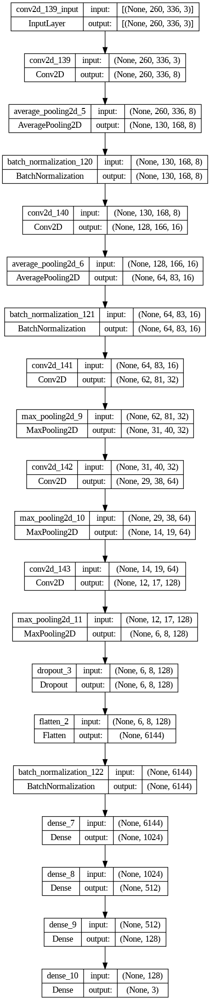

In [ ]:
tf.keras.utils.plot_model(classic_model_BN, show_shapes=True)

In [ ]:
classic_model_BN.compile(optimizer= tf.keras.optimizers.experimental.AdamW(), loss='categorical_crossentropy', metrics=['accuracy'])

**Compile and fit the mode**

In [ ]:
# Fit the model
classic_model_BN_history = classic_model_BN.fit(training_set,
                    steps_per_epoch = STEP_SIZE_TRAIN,
                    validation_data = validation_set,
                    validation_steps = STEP_SIZE_VALID,
                    epochs = epochs,
                    class_weight = class_weights,
                    callbacks = callbacks
)

Epoch 1/30
29/29 [==============================] - 41s 1s/step - loss: 0.9602 - accuracy: 0.5119 - val_loss: 0.6282 - val_accuracy: 0.8542 - lr: 1.0000e-04
Epoch 2/30
29/29 [==============================] - 36s 1s/step - loss: 0.5676 - accuracy: 0.7327 - val_loss: 0.6318 - val_accuracy: 0.7708 - lr: 1.0000e-04
Epoch 3/30
29/29 [==============================] - 36s 1s/step - loss: 0.4259 - accuracy: 0.8377 - val_loss: 0.3818 - val_accuracy: 0.8750 - lr: 1.0000e-04
Epoch 4/30
29/29 [==============================] - 37s 1s/step - loss: 0.3732 - accuracy: 0.8496 - val_loss: 0.4000 - val_accuracy: 0.8854 - lr: 1.6000e-05
Epoch 5/30
29/29 [==============================] - 36s 1s/step - loss: 0.3588 - accuracy: 0.8626 - val_loss: 0.4576 - val_accuracy: 0.8854 - lr: 1.6000e-05
Epoch 6/30
29/29 [==============================] - 34s 1s/step - loss: 0.3698 - accuracy: 0.8680 - val_loss: 0.3759 - val_accuracy: 0.8750 - lr: 1.6000e-05
Epoch 7/30
29/29 [==============================] - 35s 1s

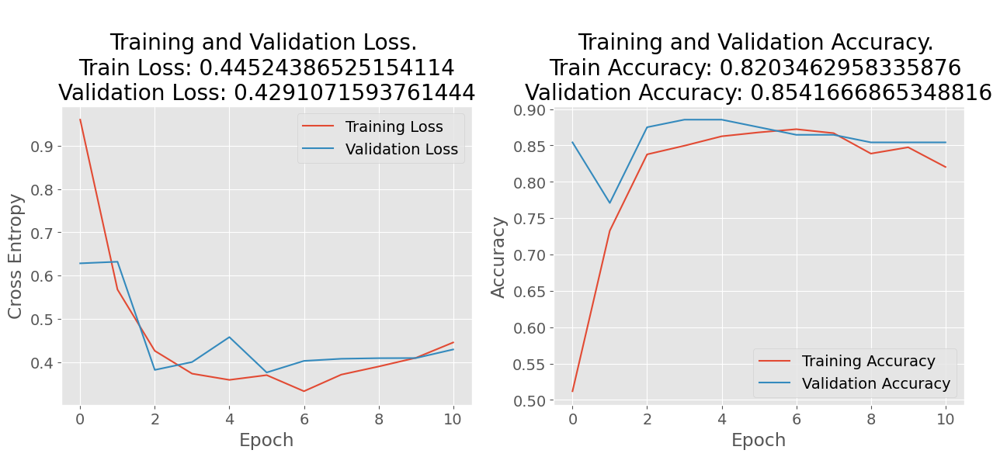

In [ ]:
# Visualize accurecy and loss curves.
plot_acc_loss_curves(classic_model_BN_history)

Evaluating Classic Model with BachNormalization network using confusion matrix ...
4/4 [==============================] - 2s 506ms/step


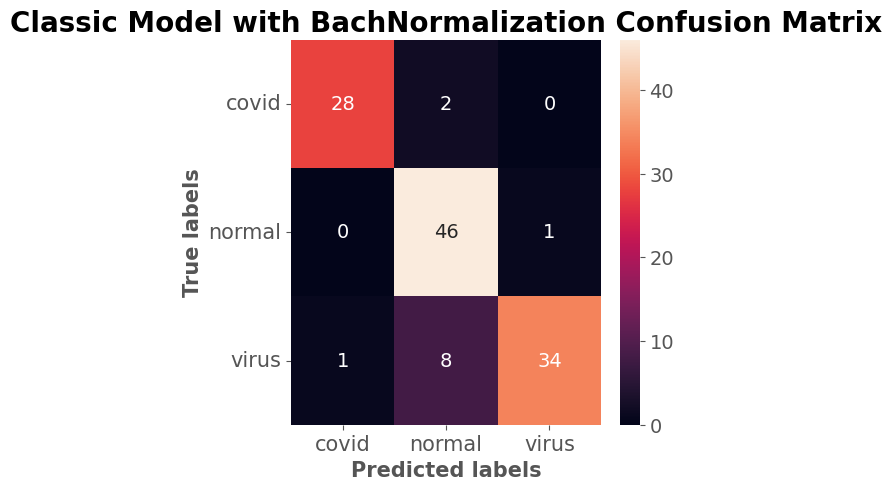

In [ ]:
evaluate_model_cmr("Classic Model with BachNormalization", classic_model_BN, test_set, test_set.labels, BATCH_SIZE, reverse_mapping)

In [ ]:
# Visualize classification report.
print(evaluate_model_cr("Classic Model with BachNormalization", classic_model_BN, test_set, test_set.labels, BATCH_SIZE, reverse_mapping))

Evaluating Classic Model with BachNormalization network ...
4/4 [==============================] - 2s 438ms/step
              precision    recall  f1-score   support

       covid       0.97      0.93      0.95        30
      normal       0.82      0.98      0.89        47
       virus       0.97      0.79      0.87        43

    accuracy                           0.90       120
   macro avg       0.92      0.90      0.90       120
weighted avg       0.91      0.90      0.90       120



{'covid': 68.371, 'normal': 0.1, 'virus': 31.53}
{'covid': 0.598, 'normal': 28.277, 'virus': 71.126}
{'covid': 0.0, 'normal': 88.925, 'virus': 11.075}
{'covid': 0.024, 'normal': 0.15, 'virus': 99.826}
{'covid': 0.0, 'normal': 100.0, 'virus': 0.0}
{'covid': 0.0, 'normal': 88.925, 'virus': 11.075}
{'covid': 0.003, 'normal': 99.05, 'virus': 0.947}
{'covid': 0.025, 'normal': 93.027, 'virus': 6.949}
{'covid': 0.001, 'normal': 99.657, 'virus': 0.343}
{'covid': 0.009, 'normal': 47.923, 'virus': 52.068}


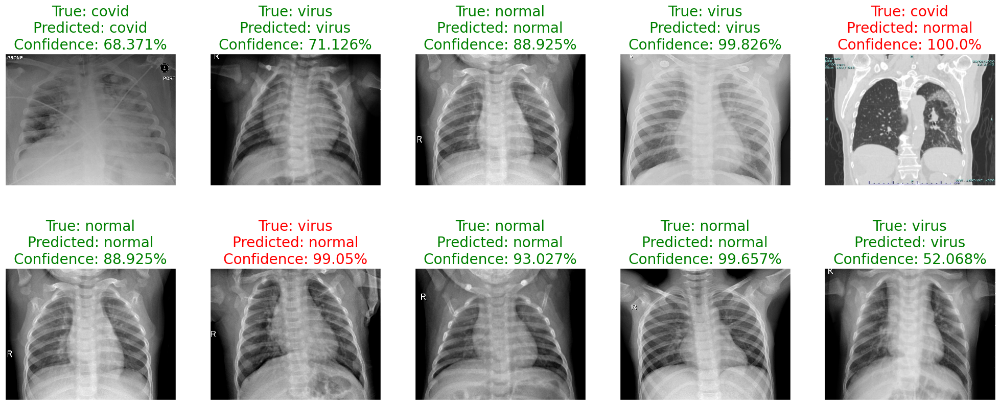

<Figure size 1600x500 with 0 Axes>

In [ ]:
# Predict test set and visualize the prediction probabilities.
model_predictions_map(test_set, classic_model_BN, BATCH_SIZE, reverse_mapping)

## Transfer Learning

**Discussion Stage**
* After I did some research, I found that `DenseNet` and `VGG` are the best choice for the dataset.

### DenseNet

In [ ]:
# Early stopping to monitor the validation loss and avoid overfitting.
transfer_model_early_stop = tf.keras.callbacks.EarlyStopping(monitor = "val_loss",
                      patience = 10)
# Reduce LR on Plateau to stabilize the training process of the model.
transfer_model_learning_rate_reduction = tf.keras.callbacks.ReduceLROnPlateau(monitor = "val_loss",
                                          patience = 3,
                                          verbose = 1,
                                          factor = 0.2,
                                          cooldown = 0,
                                          min_delt = 1e-7)


In [ ]:
base_densenet_model = DenseNet201(input_shape=(FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2, 3), weights='imagenet', include_top=False)
# for layer in base_densenet_model.layers:
#   layer.trainable = False
# base_densenet_model.summary()

74836368/74836368 [==============================] - 4s 0us/step


In [ ]:
# Freezing all layers except last 7

base_densenet_model.trainable = True

Trainable_Layers = 7

for layer in base_densenet_model.layers[ : -Trainable_Layers]:
    layer.trainable = False
# Plot the model summary.
base_densenet_model.summary()

Model: "densenet201"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 260, 336, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 266, 342, 3)  0          ['input_2[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 130, 168, 64  9408        ['zero_padding2d[0][0]']         
                                )                                                                 
                                                                                        

**Discussion Stage**
* I tried to not train the algorithm layer, but lately I found that in our case training some layer will be good, and results would be better, and this is the same of the subsequent algorithms..

In [ ]:
custom_densenet_model = tf.keras.Sequential([
    base_densenet_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(128, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(64, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dense(n_classes, activation = "softmax", kernel_initializer="GlorotUniform")
])
# Plot the model summary.
custom_densenet_model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 densenet201 (Functional)    (None, 8, 10, 1920)       18321984  
                                                                 
 global_average_pooling2d_1   (None, 1920)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_11 (Dense)            (None, 128)               245888    
                                                                 
 dropout_4 (Dropout)         (None, 128)               0         
                                                                 
 dense_12 (Dense)            (None, 64)                8256      
                                                                 
 dense_13 (Dense)            (None, 3)                 195       
                                                      

**Discussion Stage**
* I tried different algorithms architecture, and hyperparameters, and I placed the best of it, and this is the same of the subsequent algorithms.

**Compile and fit the model**

In [ ]:
custom_densenet_model.compile(optimizer= tf.keras.optimizers.experimental.AdamW(), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
# Fit the model
custom_densenet_model_history = custom_densenet_model.fit(training_set,
                    steps_per_epoch = STEP_SIZE_TRAIN,
                    validation_data = validation_set,
                    validation_steps = STEP_SIZE_VALID,
                    epochs = epochs,
                    class_weight = class_weights,
                    callbacks = [transfer_model_early_stop, transfer_model_learning_rate_reduction],
                    verbose= 1
)

Epoch 1/30
29/29 [==============================] - 59s 1s/step - loss: 0.5613 - accuracy: 0.7478 - val_loss: 0.3118 - val_accuracy: 0.8958 - lr: 0.0010
Epoch 2/30
29/29 [==============================] - 40s 1s/step - loss: 0.2432 - accuracy: 0.9134 - val_loss: 0.1750 - val_accuracy: 0.9375 - lr: 0.0010
Epoch 3/30
29/29 [==============================] - 37s 1s/step - loss: 0.2088 - accuracy: 0.9199 - val_loss: 0.2411 - val_accuracy: 0.9167 - lr: 0.0010
Epoch 4/30
29/29 [==============================] - 40s 1s/step - loss: 0.1480 - accuracy: 0.9481 - val_loss: 0.1142 - val_accuracy: 0.9583 - lr: 0.0010
Epoch 5/30
29/29 [==============================] - 39s 1s/step - loss: 0.1338 - accuracy: 0.9448 - val_loss: 0.1155 - val_accuracy: 0.9583 - lr: 0.0010
Epoch 6/30
29/29 [==============================] - 40s 1s/step - loss: 0.1136 - accuracy: 0.9535 - val_loss: 0.0537 - val_accuracy: 0.9792 - lr: 0.0010
Epoch 7/30
29/29 [==============================] - 40s 1s/step - loss: 0.1056 - a

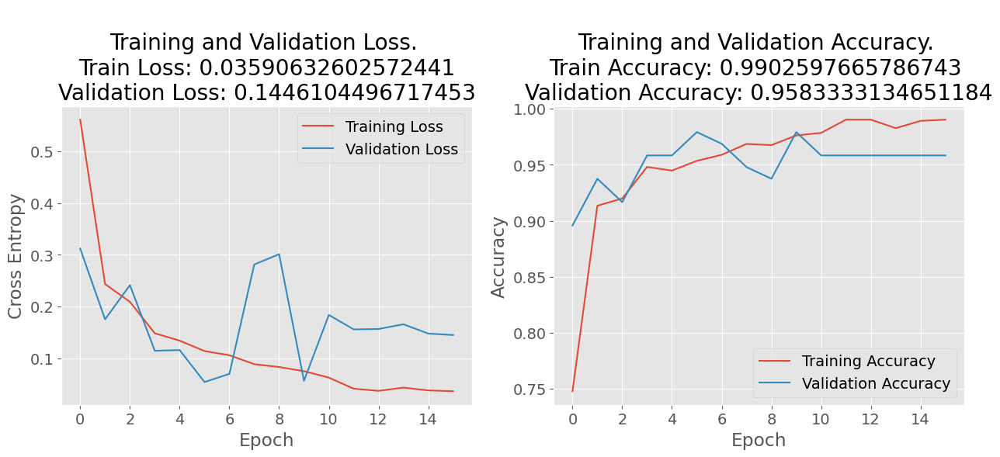

In [ ]:
# Visualize accuracy and loss curves.
plot_acc_loss_curves(custom_densenet_model_history)

Evaluating Dense Net network using confusion matrix ...
4/4 [==============================] - 8s 2s/step


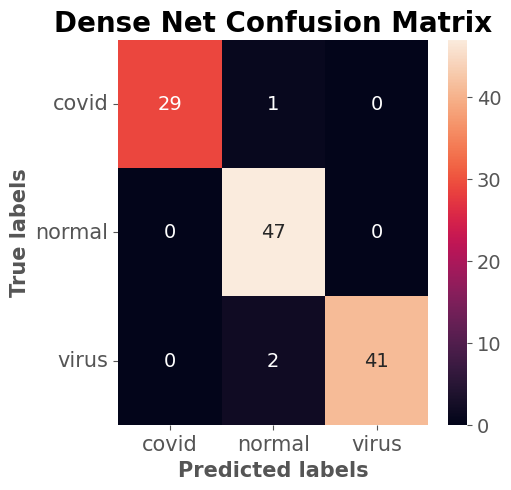

In [ ]:
# Visualize confusion matrix report.
evaluate_model_cmr("Dense Net", custom_densenet_model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping)

In [ ]:
# Visualize classification report.
print(evaluate_model_cr("Dense Net", custom_densenet_model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping))

Evaluating Dense Net network ...
4/4 [==============================] - 2s 501ms/step
              precision    recall  f1-score   support

       covid       1.00      0.97      0.98        30
      normal       0.94      1.00      0.97        47
       virus       1.00      0.95      0.98        43

    accuracy                           0.97       120
   macro avg       0.98      0.97      0.98       120
weighted avg       0.98      0.97      0.98       120



{'covid': 0.361, 'normal': 62.733, 'virus': 36.906}
{'covid': 0.361, 'normal': 62.733, 'virus': 36.906}
{'covid': 0.003, 'normal': 99.952, 'virus': 0.045}
{'covid': 0.361, 'normal': 62.733, 'virus': 36.906}
{'covid': 1.326, 'normal': 0.332, 'virus': 98.342}
{'covid': 99.998, 'normal': 0.002, 'virus': 0.0}
{'covid': 100.0, 'normal': 0.0, 'virus': 0.0}
{'covid': 0.002, 'normal': 99.982, 'virus': 0.016}
{'covid': 0.0, 'normal': 99.999, 'virus': 0.001}
{'covid': 0.617, 'normal': 5.231, 'virus': 94.152}


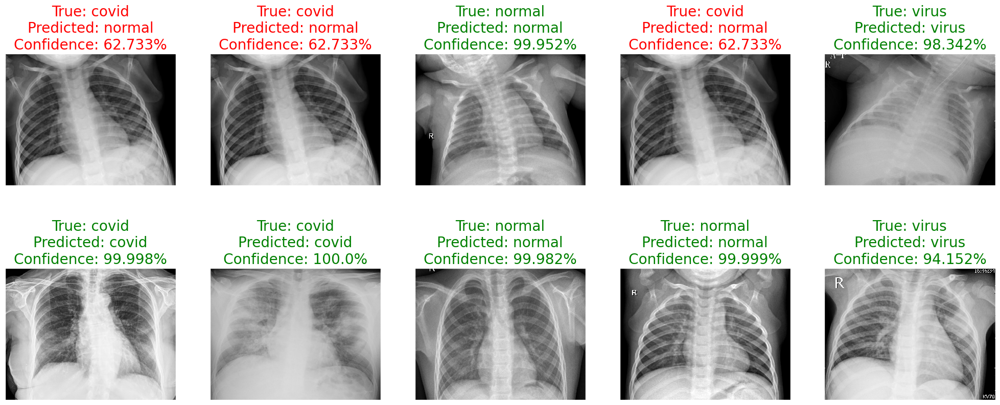

<Figure size 1600x500 with 0 Axes>

In [ ]:
# Predict test set and visualize the prediction probabilities.
model_predictions_map(test_set, custom_densenet_model, BATCH_SIZE, reverse_mapping)

### VGG16

In [ ]:
vgg_model = VGG16(weights="imagenet", include_top=False, input_shape= (FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2, 3))
for layer in vgg_model.layers:
  layer.trainable = False
vgg_model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 260, 336, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 260, 336, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 260, 336, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 130, 168, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 130, 168, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 130, 168, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 65, 84, 128)       0     

In [ ]:
# # Freezing all layers except last 5

# vgg_model.trainable = True

# Trainable_Layers = 5

# for layer in vgg_model.layers[ : -Trainable_Layers ]:
#     layer.trainable = False

# vgg_model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 260, 336, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 260, 336, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 260, 336, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 130, 168, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 130, 168, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 130, 168, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 65, 84, 128)       0     

In [ ]:
custom_vgg_model = tf.keras.Sequential([
    vgg_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(4096, activation='relu'),
    tf.keras.layers.Dense(1024, activation='relu'),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(n_classes, activation='softmax')
])
# Plot the model summary.
custom_vgg_model.summary()

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 8, 10, 512)        14714688  
                                                                 
 global_average_pooling2d_7   (None, 512)              0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_30 (Dense)            (None, 4096)              2101248   
                                                                 
 dense_31 (Dense)            (None, 1024)              4195328   
                                                                 
 dropout_13 (Dropout)        (None, 1024)              0         
                                                                 
 dense_32 (Dense)            (None, 3)                 3075      
                                                      

**Compile and fit the model**

In [ ]:
custom_vgg_model.compile(optimizer= tf.keras.optimizers.experimental.AdamW(0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
# Fit the model.
custom_vgg_model_history = custom_vgg_model.fit(training_set,
                    steps_per_epoch = STEP_SIZE_TRAIN,
                    validation_data = validation_set,
                    validation_steps = STEP_SIZE_VALID,
                    epochs = epochs,
                    class_weight = class_weights,
                    callbacks = [transfer_model_early_stop, transfer_model_learning_rate_reduction],
                    verbose= 1
)

Epoch 1/30
29/29 [==============================] - 38s 1s/step - loss: 0.9616 - accuracy: 0.5563 - val_loss: 0.7764 - val_accuracy: 0.7396 - lr: 1.0000e-04
Epoch 2/30
29/29 [==============================] - 36s 1s/step - loss: 0.7475 - accuracy: 0.7262 - val_loss: 0.6308 - val_accuracy: 0.7188 - lr: 1.0000e-04
Epoch 3/30
29/29 [==============================] - 36s 1s/step - loss: 0.5747 - accuracy: 0.8041 - val_loss: 0.4612 - val_accuracy: 0.8854 - lr: 1.0000e-04
Epoch 4/30
29/29 [==============================] - 36s 1s/step - loss: 0.5161 - accuracy: 0.8117 - val_loss: 0.5111 - val_accuracy: 0.8021 - lr: 1.0000e-04
Epoch 5/30
29/29 [==============================] - 37s 1s/step - loss: 0.4695 - accuracy: 0.8203 - val_loss: 0.6976 - val_accuracy: 0.7083 - lr: 1.0000e-04
Epoch 6/30
29/29 [==============================] - 35s 1s/step - loss: 0.4247 - accuracy: 0.8398 - val_loss: 0.4516 - val_accuracy: 0.8438 - lr: 1.0000e-04
Epoch 7/30
29/29 [==============================] - 41s 1s

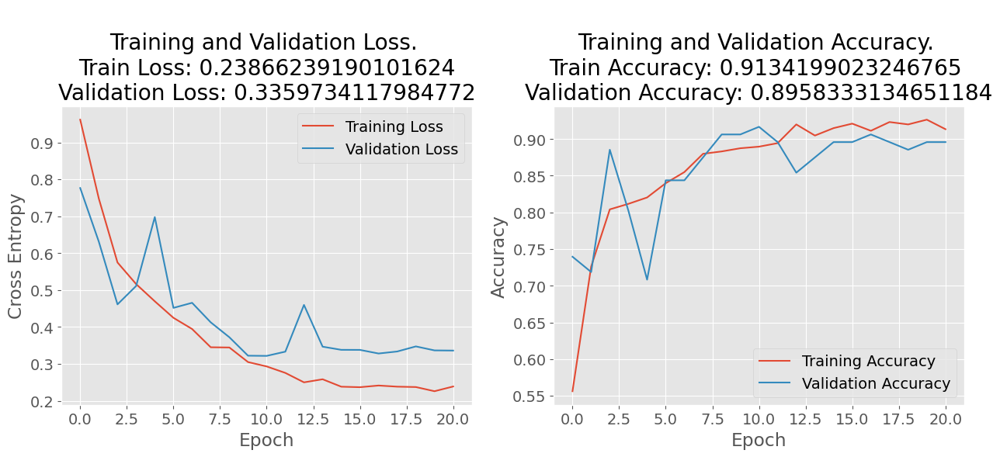

In [ ]:
# Visualize accuracy and loss curves.
plot_acc_loss_curves(custom_vgg_model_history)

Evaluating VGG16 network using confusion matrix ...
4/4 [==============================] - 2s 486ms/step


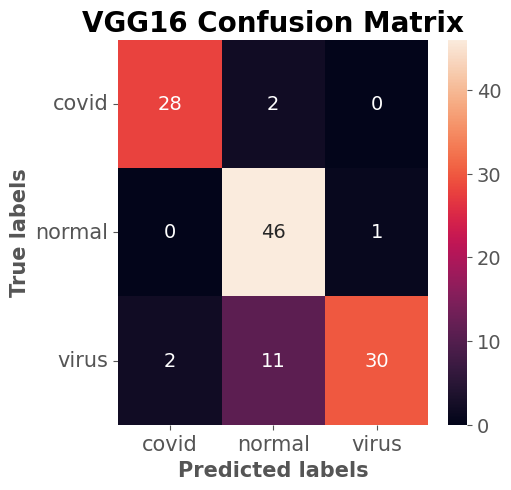

In [ ]:
# Visualize confusion matrix report.
evaluate_model_cmr("VGG16", custom_vgg_model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping)

In [ ]:
# Visualize classification report.
print(evaluate_model_cr("VGG16", custom_vgg_model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping))

Evaluating VGG16 network ...
4/4 [==============================] - 2s 477ms/step
              precision    recall  f1-score   support

       covid       0.93      0.93      0.93        30
      normal       0.78      0.98      0.87        47
       virus       0.97      0.70      0.81        43

    accuracy                           0.87       120
   macro avg       0.89      0.87      0.87       120
weighted avg       0.89      0.87      0.86       120



{'covid': 0.003, 'normal': 99.771, 'virus': 0.226}
{'covid': 97.995, 'normal': 0.038, 'virus': 1.968}
{'covid': 97.995, 'normal': 0.038, 'virus': 1.968}
{'covid': 0.008, 'normal': 96.534, 'virus': 3.458}
{'covid': 0.579, 'normal': 53.743, 'virus': 45.678}
{'covid': 97.995, 'normal': 0.038, 'virus': 1.968}
{'covid': 95.822, 'normal': 0.013, 'virus': 4.165}
{'covid': 0.004, 'normal': 99.25, 'virus': 0.746}
{'covid': 0.004, 'normal': 99.25, 'virus': 0.746}
{'covid': 15.337, 'normal': 8.598, 'virus': 76.065}


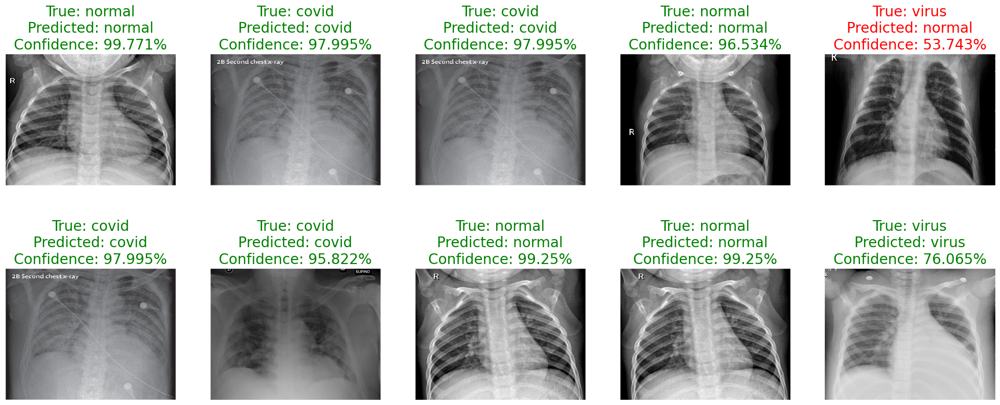

<Figure size 1600x500 with 0 Axes>

In [ ]:
# Predict test set and visualize the prediction probabilities.
model_predictions_map(test_set, custom_vgg_model, BATCH_SIZE, reverse_mapping)

### VGG19

In [ ]:
vgg19_model = VGG19(weights="imagenet", include_top=False, input_shape= (FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2, 3))
for layer in vgg19_model.layers:
  layer.trainable = False
vgg19_model.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 260, 336, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 260, 336, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 260, 336, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 130, 168, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 130, 168, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 130, 168, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 65, 84, 128)       0     

In [ ]:
# # Freezing all layers except last 10

# vgg19_model.trainable = True

# Trainable_Layers = 10

# for layer in vgg19_model.layers[ : -Trainable_Layers ]:
#     layer.trainable = False

# vgg19_model.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 260, 336, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 260, 336, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 260, 336, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 130, 168, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 130, 168, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 130, 168, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 65, 84, 128)       0     

In [ ]:
custom_vgg19_model = tf.keras.Sequential([
    vgg19_model,
    tf.keras.layers.BatchNormalization(renorm=True),
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(2096, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dense(1024, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(n_classes, activation = "softmax", kernel_initializer="GlorotUniform")
])
custom_vgg19_model.summary()

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg19 (Functional)          (None, 8, 10, 512)        20024384  
                                                                 
 batch_normalization_125 (Ba  (None, 8, 10, 512)       3584      
 tchNormalization)                                               
                                                                 
 global_average_pooling2d_11  (None, 512)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_42 (Dense)            (None, 2096)              1075248   
                                                                 
 dense_43 (Dense)            (None, 1024)              2147328   
                                                                 
 dropout_17 (Dropout)        (None, 1024)            

**Compile and fit the model**

In [ ]:
custom_vgg19_model.compile(optimizer= tf.keras.optimizers.experimental.AdamW(0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
# Fit the model
custom_vgg19_model_history = custom_vgg19_model.fit(training_set,
                    steps_per_epoch = STEP_SIZE_TRAIN,
                    validation_data = validation_set,
                    validation_steps = STEP_SIZE_VALID,
                    epochs = epochs,
                    class_weight = class_weights,
                    callbacks = [transfer_model_early_stop, transfer_model_learning_rate_reduction],
                    verbose= 1
)

Epoch 1/30
29/29 [==============================] - 41s 1s/step - loss: 0.9905 - accuracy: 0.4968 - val_loss: 0.7082 - val_accuracy: 0.7604 - lr: 1.0000e-04
Epoch 2/30
29/29 [==============================] - 41s 1s/step - loss: 0.7106 - accuracy: 0.6851 - val_loss: 0.5650 - val_accuracy: 0.7708 - lr: 1.0000e-04
Epoch 3/30
29/29 [==============================] - 37s 1s/step - loss: 0.5683 - accuracy: 0.7695 - val_loss: 0.4161 - val_accuracy: 0.8854 - lr: 1.0000e-04
Epoch 4/30
29/29 [==============================] - 39s 1s/step - loss: 0.4423 - accuracy: 0.8442 - val_loss: 0.3555 - val_accuracy: 0.8958 - lr: 1.0000e-04
Epoch 5/30
29/29 [==============================] - 37s 1s/step - loss: 0.3553 - accuracy: 0.8690 - val_loss: 0.2767 - val_accuracy: 0.9271 - lr: 1.0000e-04
Epoch 6/30
29/29 [==============================] - 37s 1s/step - loss: 0.3039 - accuracy: 0.8831 - val_loss: 0.2578 - val_accuracy: 0.9375 - lr: 1.0000e-04
Epoch 7/30
29/29 [==============================] - 38s 1s

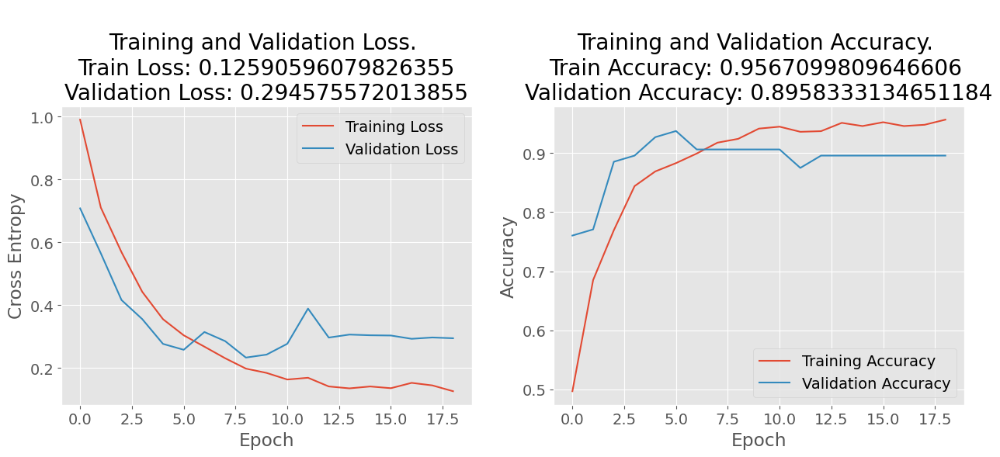

In [ ]:
# Visualize accuracy and loss curves.
plot_acc_loss_curves(custom_vgg19_model_history)

Evaluating VGG19 network using confusion matrix ...
4/4 [==============================] - 2s 514ms/step


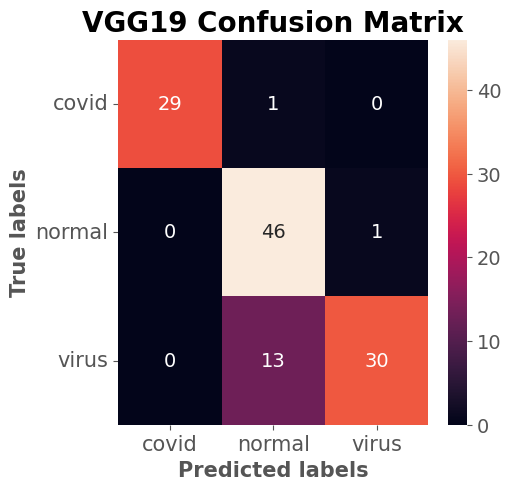

In [ ]:
# Visualize confusion matrix report.
evaluate_model_cmr("VGG19", custom_vgg19_model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping)

In [ ]:
# Visualize classification report.
print(evaluate_model_cr("VGG19", custom_vgg19_model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping))

Evaluating VGG19 network ...
4/4 [==============================] - 3s 681ms/step
              precision    recall  f1-score   support

       covid       1.00      0.97      0.98        30
      normal       0.77      0.98      0.86        47
       virus       0.97      0.70      0.81        43

    accuracy                           0.88       120
   macro avg       0.91      0.88      0.88       120
weighted avg       0.90      0.88      0.87       120



{'covid': 0.0, 'normal': 99.974, 'virus': 0.026}
{'covid': 98.218, 'normal': 0.018, 'virus': 1.764}
{'covid': 0.003, 'normal': 99.952, 'virus': 0.045}
{'covid': 0.055, 'normal': 58.957, 'virus': 40.988}
{'covid': 0.0, 'normal': 99.925, 'virus': 0.075}
{'covid': 0.117, 'normal': 1.149, 'virus': 98.734}
{'covid': 0.42, 'normal': 95.073, 'virus': 4.508}
{'covid': 0.0, 'normal': 99.925, 'virus': 0.075}
{'covid': 0.003, 'normal': 72.242, 'virus': 27.755}
{'covid': 95.645, 'normal': 3.67, 'virus': 0.685}


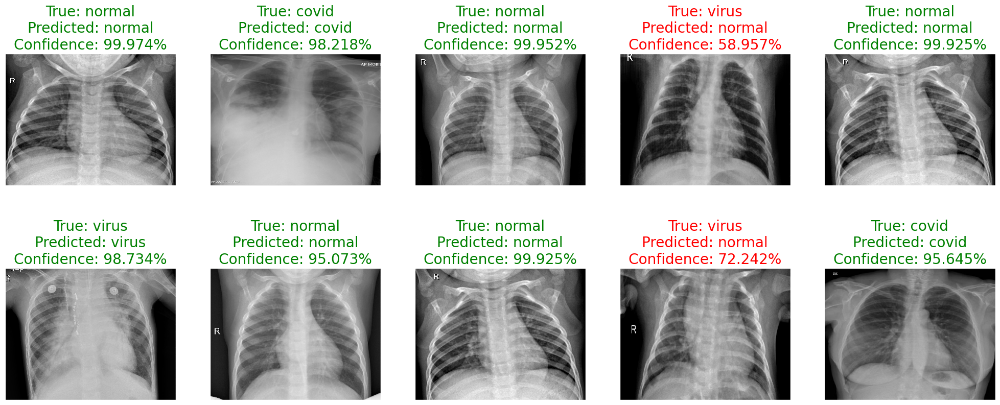

<Figure size 1600x500 with 0 Axes>

In [ ]:
# Predict test set and visualize the prediction probabilities.
model_predictions_map(test_set, custom_vgg19_model, BATCH_SIZE, reverse_mapping)

### InceptionV3

In [ ]:
InceptionV3_Model = InceptionV3(weights="imagenet", include_top=False, input_shape= (FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2, 3))
# #construct the head of the model that will be placed on top of the
# for layer in InceptionV3_Model.layers:
#     layer.trainable = False


# Freezing all layers except last 7

InceptionV3_Model.trainable = True

Trainable_Layers = 7

for layer in InceptionV3_Model.layers[ : -Trainable_Layers ]:
    layer.trainable = False

custom_InceptionV3_model = tf.keras.Sequential([
    InceptionV3_Model,
    # tf.keras.layers.BatchNormalization(renorm=True),
    # tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(1024, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dropout(0.2),
    # tf.keras.layers.Dense(128, kernel_initializer="he_normal", activation = 'relu'),
    # tf.keras.layers.Dropout(0.5),
    # tf.keras.layers.Dense(64, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dense(n_classes, activation = "softmax", kernel_initializer="GlorotUniform")
])
# Plot the model summary.
custom_InceptionV3_model.summary()

87910968/87910968 [==============================] - 3s 0us/step
Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 6, 9, 2048)        21802784  
                                                                 
 flatten_3 (Flatten)         (None, 110592)            0         
                                                                 
 dense_45 (Dense)            (None, 1024)              113247232 
                                                                 
 dropout_18 (Dropout)        (None, 1024)              0         
                                                                 
 dense_46 (Dense)            (None, 3)                 3075      
                                                                 
Total params: 135,053,091
Trainable params: 113,250,499
Non-trainable params: 21,802,592
_______________________________

**Compile and fit the model**

In [ ]:
custom_InceptionV3_model.compile(optimizer= tf.keras.optimizers.experimental.AdamW(0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
# Fit the model.
custom_InceptionV3_model_history = custom_InceptionV3_model.fit(training_set,
                    steps_per_epoch = STEP_SIZE_TRAIN,
                    validation_data = validation_set,
                    validation_steps = STEP_SIZE_VALID,
                    epochs = epochs,
                    class_weight = class_weights,
                    callbacks = [transfer_model_early_stop, transfer_model_learning_rate_reduction],
                    verbose= 1
)

Epoch 1/30
29/29 [==============================] - 44s 1s/step - loss: 3.2273 - accuracy: 0.7197 - val_loss: 2.5799 - val_accuracy: 0.7083 - lr: 1.0000e-04
Epoch 2/30
29/29 [==============================] - 35s 1s/step - loss: 0.8102 - accuracy: 0.8604 - val_loss: 0.6127 - val_accuracy: 0.8542 - lr: 1.0000e-04
Epoch 3/30
29/29 [==============================] - 37s 1s/step - loss: 0.4289 - accuracy: 0.9037 - val_loss: 0.8099 - val_accuracy: 0.7917 - lr: 1.0000e-04
Epoch 4/30
29/29 [==============================] - 35s 1s/step - loss: 0.3876 - accuracy: 0.9102 - val_loss: 0.4633 - val_accuracy: 0.8438 - lr: 1.0000e-04
Epoch 5/30
29/29 [==============================] - 34s 1s/step - loss: 0.3092 - accuracy: 0.9048 - val_loss: 0.2537 - val_accuracy: 0.9375 - lr: 1.0000e-04
Epoch 6/30
29/29 [==============================] - 35s 1s/step - loss: 0.1598 - accuracy: 0.9448 - val_loss: 0.2319 - val_accuracy: 0.8750 - lr: 1.0000e-04
Epoch 7/30
29/29 [==============================] - 35s 1s

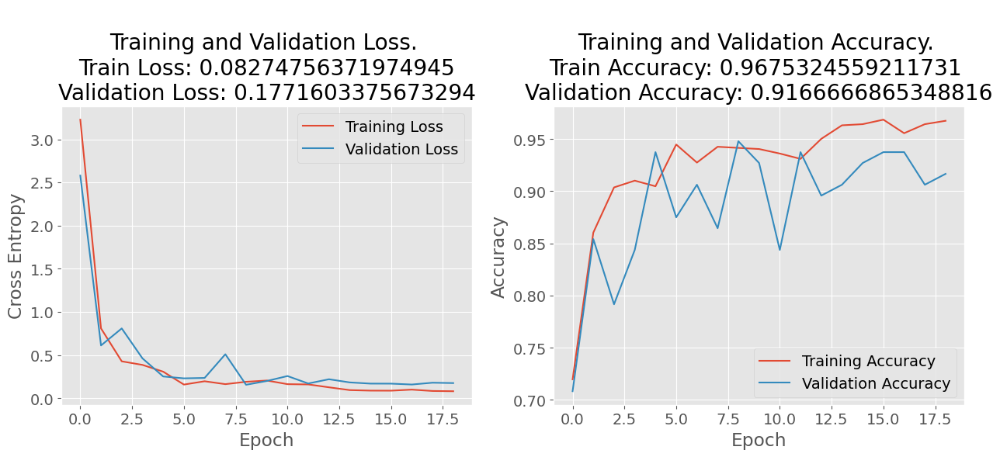

In [ ]:
# Visualize accuracy and loss curves.
plot_acc_loss_curves(custom_InceptionV3_model_history)

Evaluating Inception network using confusion matrix ...
4/4 [==============================] - 5s 1s/step


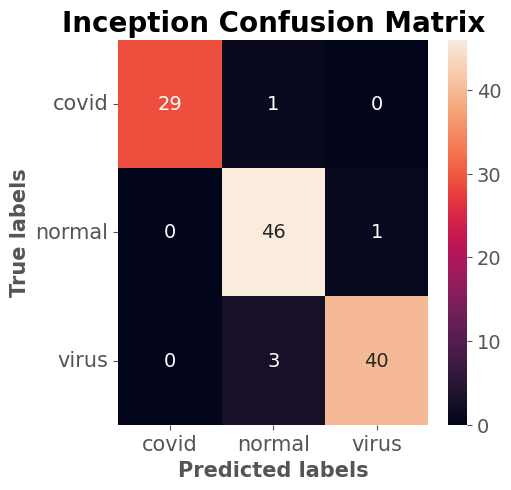

In [ ]:
# Visualize confusion matrix report.
evaluate_model_cmr("Inception", custom_InceptionV3_model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping)

In [ ]:
# Visualize classification report.
print(evaluate_model_cr("Inception", custom_InceptionV3_model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping))

Evaluating Inception network ...
4/4 [==============================] - 2s 440ms/step
              precision    recall  f1-score   support

       covid       1.00      0.97      0.98        30
      normal       0.92      0.98      0.95        47
       virus       0.98      0.93      0.95        43

    accuracy                           0.96       120
   macro avg       0.97      0.96      0.96       120
weighted avg       0.96      0.96      0.96       120



{'covid': 100.0, 'normal': 0.0, 'virus': 0.0}
{'covid': 0.001, 'normal': 57.391, 'virus': 42.609}
{'covid': 0.0, 'normal': 0.153, 'virus': 99.847}
{'covid': 0.001, 'normal': 57.391, 'virus': 42.609}
{'covid': 0.001, 'normal': 98.781, 'virus': 1.218}
{'covid': 0.0, 'normal': 99.354, 'virus': 0.646}
{'covid': 100.0, 'normal': 0.0, 'virus': 0.0}
{'covid': 0.006, 'normal': 98.423, 'virus': 1.571}
{'covid': 100.0, 'normal': 0.0, 'virus': 0.0}
{'covid': 0.0, 'normal': 98.281, 'virus': 1.719}


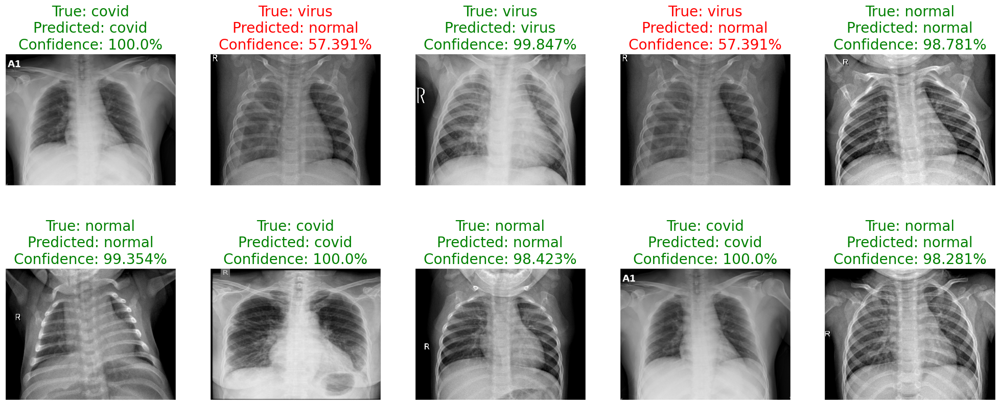

<Figure size 1600x500 with 0 Axes>

In [ ]:
# Predict test set and visualize the prediction probabilities.
model_predictions_map(test_set, custom_InceptionV3_model, BATCH_SIZE, reverse_mapping)

### ResNet

In [ ]:
resnet50_Model = ResNet50(weights="imagenet", include_top=False, input_shape= (FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2, 3))
#construct the head of the model that will be placed on top of the
for layer in resnet50_Model.layers:
    layer.trainable = False

# InceptionV3_Model.trainable = True

# Trainable_Layers = 10

# for layer in InceptionV3_Model.layers[ : -Trainable_Layers]:
#     layer.trainable = False

custom_resnet50_Model = tf.keras.Sequential([
    resnet50_Model,
    tf.keras.layers.BatchNormalization(renorm=True),
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(256, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(128, kernel_initializer="he_normal", activation = 'relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(64, kernel_initializer="he_normal", activation = 'relu'),
    # tf.keras.layers.Flatten(),
    # tf.keras.layers.Dense(128, kernel_initializer="he_normal", activation = 'relu'),
    # tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(n_classes, activation = "softmax", kernel_initializer="GlorotUniform")
])
custom_resnet50_Model.summary()

Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 9, 11, 2048)       23587712  
                                                                 
 batch_normalization_221 (Ba  (None, 9, 11, 2048)      14336     
 tchNormalization)                                               
                                                                 
 global_average_pooling2d_13  (None, 2048)             0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_61 (Dense)            (None, 256)               524544    
                                                                 
 dropout_26 (Dropout)        (None, 256)               0         
                                                                 
 dense_62 (Dense)            (None, 128)             

**Compile and fit the model**

In [ ]:
custom_resnet50_Model.compile(optimizer= tf.keras.optimizers.experimental.AdamW(0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
# Fit the model
custom_resnet50_Model_history = custom_resnet50_Model.fit(training_set,
                    steps_per_epoch = STEP_SIZE_TRAIN,
                    validation_data = validation_set,
                    validation_steps = STEP_SIZE_VALID,
                    epochs = epochs,
                    class_weight = class_weights,
                    callbacks = [transfer_model_early_stop, transfer_model_learning_rate_reduction],
                    verbose= 1
)

Epoch 1/30
29/29 [==============================] - 37s 1s/step - loss: 1.2136 - accuracy: 0.3074 - val_loss: 1.0882 - val_accuracy: 0.3958 - lr: 1.0000e-04
Epoch 2/30
29/29 [==============================] - 38s 1s/step - loss: 1.1066 - accuracy: 0.3290 - val_loss: 1.0992 - val_accuracy: 0.3958 - lr: 1.0000e-04
Epoch 3/30
29/29 [==============================] - 38s 1s/step - loss: 1.0978 - accuracy: 0.3528 - val_loss: 1.0849 - val_accuracy: 0.3958 - lr: 1.0000e-04
Epoch 4/30
29/29 [==============================] - 36s 1s/step - loss: 1.0973 - accuracy: 0.3409 - val_loss: 1.0846 - val_accuracy: 0.4583 - lr: 1.0000e-04
Epoch 5/30
29/29 [==============================] - 37s 1s/step - loss: 1.0873 - accuracy: 0.4102 - val_loss: 1.0746 - val_accuracy: 0.5833 - lr: 1.0000e-04
Epoch 6/30
29/29 [==============================] - 36s 1s/step - loss: 1.0708 - accuracy: 0.4545 - val_loss: 1.0516 - val_accuracy: 0.6042 - lr: 1.0000e-04
Epoch 7/30
29/29 [==============================] - 35s 1s

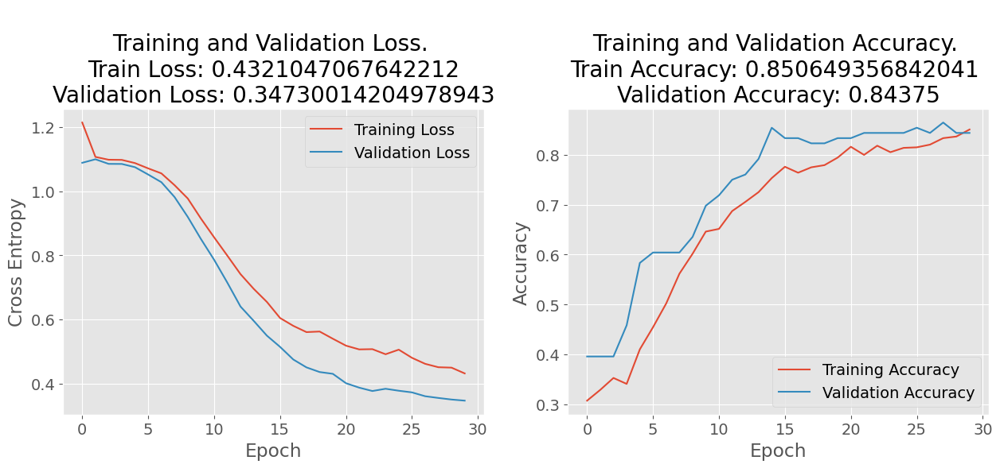

In [ ]:
# Visualize accuracy and loss curves.
plot_acc_loss_curves(custom_resnet50_Model_history)

Evaluating ResNet network using confusion matrix ...
4/4 [==============================] - 4s 1s/step


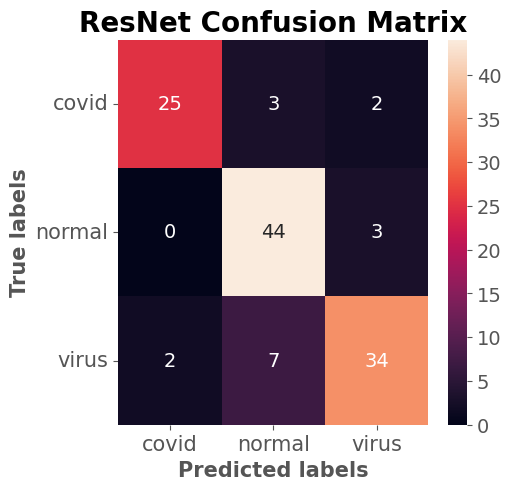

In [ ]:
# Visualize confusion matrix report.
evaluate_model_cmr("ResNet", custom_resnet50_Model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping)

In [ ]:
# Visualize classification report.
print(evaluate_model_cr("ResNet", custom_resnet50_Model, test_set, test_set.labels, BATCH_SIZE, reverse_mapping))

Evaluating ResNet network ...
4/4 [==============================] - 2s 501ms/step
              precision    recall  f1-score   support

       covid       0.93      0.83      0.88        30
      normal       0.81      0.94      0.87        47
       virus       0.87      0.79      0.83        43

    accuracy                           0.86       120
   macro avg       0.87      0.85      0.86       120
weighted avg       0.86      0.86      0.86       120



{'covid': 2.842, 'normal': 2.07, 'virus': 95.088}
{'covid': 21.929, 'normal': 7.692, 'virus': 70.379}
{'covid': 0.099, 'normal': 98.712, 'virus': 1.189}
{'covid': 4.202, 'normal': 9.36, 'virus': 86.438}
{'covid': 84.99, 'normal': 7.839, 'virus': 7.171}
{'covid': 93.416, 'normal': 0.314, 'virus': 6.269}
{'covid': 0.738, 'normal': 94.79, 'virus': 4.472}
{'covid': 2.815, 'normal': 6.993, 'virus': 90.191}
{'covid': 0.628, 'normal': 93.622, 'virus': 5.75}
{'covid': 78.616, 'normal': 4.921, 'virus': 16.463}


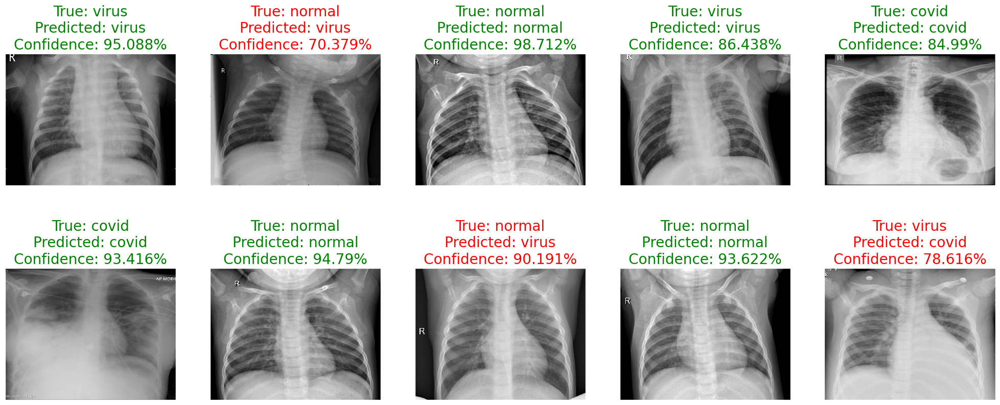

<Figure size 1600x500 with 0 Axes>

In [ ]:
# Predict test set and visualize the prediction probabilities.
model_predictions_map(test_set, custom_resnet50_Model, BATCH_SIZE, reverse_mapping)

**Discussion Stage**

**Finally, I will summarize some of my approaches:**
* I tried several optimization algorithms, and I found after research and experimentation that `AdamW` is the best.
* I tried several callback methods, using different learning rate decay methods, and early stop, also manipulating with there hyperparameters etc., and address the best of it.
* I use several architectures of Custom CNN, and also transfer learning, using BachNormalization, dropout, Conv2D, MaxPooling2D, AveragePooling2D, Dense, and GlobalAveragePooling, etc., and I address the best of it.
* I use several bias, kernel initializer, activation function, with different filters counts, size, padding and etc.

# Make Submission

In [ ]:
TEST_DIR = os.path.join(data_path, "test")
test_images_names = []
test_images_data = []
for img_name in os.listdir(TEST_DIR):
    img = os.path.join(TEST_DIR, img_name)
    img = cv2.imread(img, cv2.IMREAD_COLOR)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = x = cv2.resize(img, (FIXED_IMG_SIZE_1, FIXED_IMG_SIZE_2))
    img = np.expand_dims(img, axis=0)
    img = img / 255.
    test_images_names.append(img_name)
    test_images_data.append(img)

In [ ]:
images = np.vstack(test_images_data)
classes = custom_densenet_model.predict(images)
print(classes)

In [ ]:
test_dataframe = pd.read_csv(os.path.join(data_path, "sample_submission.csv"))

In [ ]:
test_dataframe

In [ ]:
submission_dataframe = pd.DataFrame(columns=["Image", "Label"])

In [ ]:
for (name_, label_) in zip(test_images_names, classes):
    submission_dataframe_sub = {"Image": name_, "Label" : str(label_encoder.inverse_transform([np.argmax(label_)])[0])}
    submission_dataframe= submission_dataframe.append(submission_dataframe_sub, ignore_index = True)

In [ ]:
submission_dataframe

In [ ]:
submission_dataframe.to_csv("Submission.csv", index=False)